## Notebook Purpose
- This notebook is used to plot six panel SMB map figures used in the main text and supplementary material for the six glaciers considered in the study.
- It also presents number on mass conservation for slope-corrected Lagrangian measurements on all the six glaicers, and for Lagrangian SMB rates measurements for Black Changri Nup and Lirung Glacier

#### Last updated: August 14, 2023

## TODO:
- Update imports when new library has been built up with all updates
- Generalise path to data products during revisions, after the data distribution plan is finalized

In [1]:
%load_ext autoreload
%autoreload 2
%config InlineBackend.figure_format='retina'
%matplotlib inline

In [3]:
import matplotlib
matplotlib.rcParams.update(matplotlib.rcParamsDefault)
#matplotlib.rc('text', usetex=True)

#matplotlib.rcParams['text.latex.preamble']=[r"\usepackage{amsmath}"]

In [24]:
import numpy as np 
import geopandas as gpd
import matplotlib.pyplot as plt
from skimage import exposure
from imview import pltlib
import pandas as pd
from pygeotools.lib import warplib,geolib,iolib,malib,filtlib,timelib
import os,sys,glob,shutil
from velocity_proc import glac_dyn, constants, velocity_filter,velocity_timeseries
import warnings
warnings.filterwarnings('ignore')

In [9]:
%matplotlib inline

In [10]:
%cd /nobackup/sbhusha1/chapter2/

/nobackupp11/sbhusha1/chapter2


In [6]:
%matplotlib widget

## 1. Imja Lhotse Shar

In [65]:
dem1_fn = 'imja/20151002_0651_10200100457F0C00_1020010042C0CE00-DEM_2m.tif'
eul_fn = 'imja/20230223/imja_farinotti_2015-10-02_to_2016-10-29_lag_smb_products/imja_farinotti_2015-10-02_to_2016-10-29_eulerian_dhdt.tif'
lag_fn = 'imja/20230223/imja_farinotti_2015-10-02_to_2016-10-29_lag_smb_products/imja_farinotti_2015-10-02_to_2016-10-29_lagrangian_dhdt.tif'
slope_parallel_fn = 'imja/20230223/imja_farinotti_2015-10-02_to_2016-10-29_lag_smb_products/imja_farinotti_2015-10-02_to_2016-10-29_downslope_dhdt.tif'
smb_fn = 'imja/20230223/imja_farinotti_2015-10-02_to_2016-10-29_lag_smb_products/imja_farinotti_2015-10-02_to_2016-10-29_smb_dhdt.tif'
ortho_img_fn = 'imja/20230223/20151002_10200100457F0C00_ortho_proc/20151002_10200100457F0C00_ortho_res_2.0m.tif'
glac_shp = gpd.read_file(constants.fetch_glac_shp(constants.rgi_dicts['imja'])).to_crs('EPSG:32645')
ds_list = warplib.memwarp_multi_fn([dem1_fn,eul_fn,lag_fn,slope_parallel_fn,smb_fn,ortho_img_fn],res='last',r='average')

dem1,eul,lag,slope_parallel,smb,ortho_img = [iolib.ds_getma(ds) for ds in ds_list]
eul = velocity_timeseries.mask_by_shp(glac_shp.geometry,eul,ds=ds_list[1])
lag = velocity_timeseries.mask_by_shp(glac_shp.geometry,lag,ds=ds_list[2])
#vx = velocity_timeseries.mask_by_shp(glac_shp.geometry,iolib.ds_getma(vx_ds),vx_ds)
#vy = velocity_timeseries.mask_by_shp(glac_shp.geometry,iolib.ds_getma(vy_ds),vy_ds)
#divq2 = velocity_timeseries.mask_by_shp(glac_shp.geometry,divq2,ds_list[2])
res = geolib.get_res(ds_list[0])[0]
ds_extent = geolib.ds_extent(ds_list[0])
fig_extent = [ds_extent[0],ds_extent[2],ds_extent[1],ds_extent[3]]
contour_extent = [fig_extent[0],fig_extent[1],fig_extent[3],fig_extent[2]] # flip y axis otherwise contours are plotted flipped


Warping all inputs to the following:
Resolution: 2.0
Extent: [492962.5, 3084912.5, 498337.5, 3092462.5]
Projection: '+proj=utm +zone=45 +datum=WGS84 +units=m +no_defs'
Resampling alg: average

1 of 6: imja/20151002_0651_10200100457F0C00_1020010042C0CE00-DEM_2m.tif
nl: 3775 ns: 2688 res: 2.000
100 - done.
0...10...20...30...40...50...60...70...80...90...2 of 6: imja/20230223/imja_farinotti_2015-10-02_to_2016-10-29_lag_smb_products/imja_farinotti_2015-10-02_to_2016-10-29_eulerian_dhdt.tif
nl: 3775 ns: 2688 res: 2.000
100 - done.
0...10...20...30...40...50...60...70...80...90...3 of 6: imja/20230223/imja_farinotti_2015-10-02_to_2016-10-29_lag_smb_products/imja_farinotti_2015-10-02_to_2016-10-29_lagrangian_dhdt.tif
nl: 3775 ns: 2688 res: 2.000
100 - done.
0...10...20...30...40...50...60...70...80...90...4 of 6: imja/20230223/imja_farinotti_2015-10-02_to_2016-10-29_lag_smb_products/imja_farinotti_2015-10-02_to_2016-10-29_downslope_dhdt.tif
nl: 3775 ns: 2688 res: 2.000
100 - done.
0...10...

### Check for mass conservation in Lagrangian corrections

In [66]:
mask = malib.common_mask([lag,slope_parallel,smb])

In [69]:
slope_corrected_lag_conservation = malib.get_stats_dict(np.ma.array(eul,mask=mask))['mean']-malib.get_stats_dict(np.ma.array(lag-slope_parallel,mask=mask))['mean']
print (f"Difference between Eul. dh/dt and slope-corrected Lag Dh/Dt for Imja Lhotse Shar Glacier is {np.round(slope_corrected_lag_conservation,2)} m/yr")

Difference between Eul. dh/dt and slope-corrected Lag Dh/Dt for Imja Lhotse Shar Glacier is 0.05 m/yr


In [19]:
pwd

'/nobackupp11/sbhusha1/chapter2'

In [18]:
malib.get_stats_dict(np.ma.array(lag-slope_parallel,mask=mask))

{'count': 1297679,
 'min': -22.807105868574645,
 'max': 24.261039297543395,
 'ptp': 47.06814516611804,
 'mean': -0.8971957619356902,
 'std': 1.9617538843038356,
 'nmad': 1.1514663917911676,
 'med': -0.6083694976725026,
 'median': -0.6083694976725026,
 'p16': -2.0968127684097575,
 'p84': 0.42735620638495414,
 'spread': 1.2620844873973558,
 'mode': -10.155397984243944}

In [11]:
%matplotlib inline

In [20]:
def norm(a, perc_lim=(2, 98), clip=True, verbose=True):
    # Written and shared by David
    #Simple approach using actual min and max values
    #amin, amax = (a.min(), a.max())
    #Check if we're using masked array or np.nan
    if np.ma.isMaskedArray(a):
        amin, amax = np.percentile(a.compressed(), perc_lim)
    else:
        amin, amax = np.nanpercentile(a, perc_lim)
    out = ((a - amin)/(amax - amin))
    #This will "clip" normalized values <0 to 0 and >1 to 1
    if clip:
        out = out.clip(0,1)
    if verbose:
        print("Input range: ({}, {})".format(a.min(), a.max()))
        print(f"Percentile range {perc_lim}: ({amin}, {amax})")
        print("Output range: ({}, {})".format(out.min(), out.max()))
    return out

In [21]:
from matplotlib.colors import LogNorm

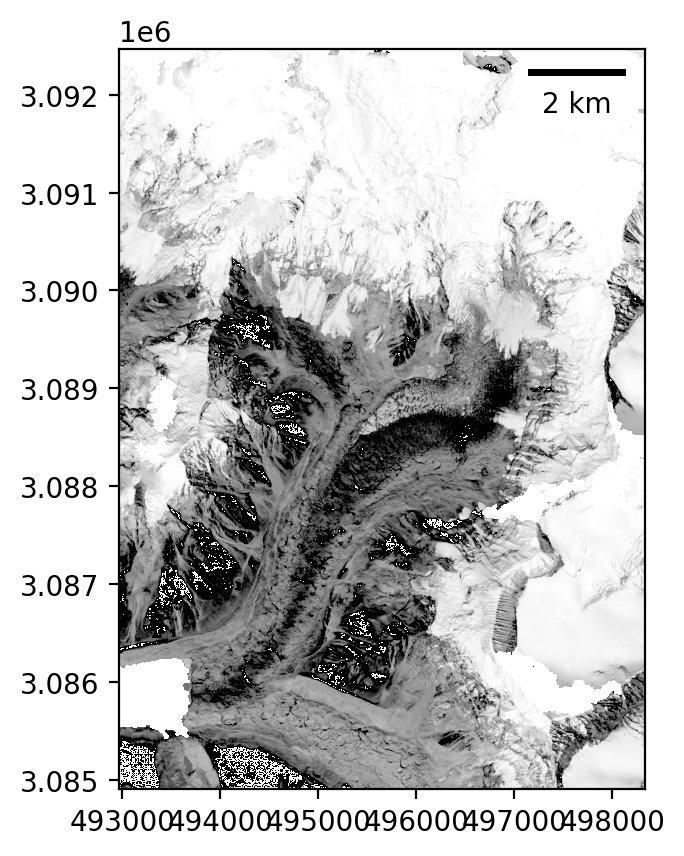

In [22]:
f,ax = plt.subplots()
im2 = ax.imshow(norm(ortho_img, verbose=False,perc_lim=(10,90)), cmap='gray', extent=fig_extent, norm=LogNorm(vmin=0.01, vmax=1))
pltlib.add_scalebar(ax,res=2,location='upper right')

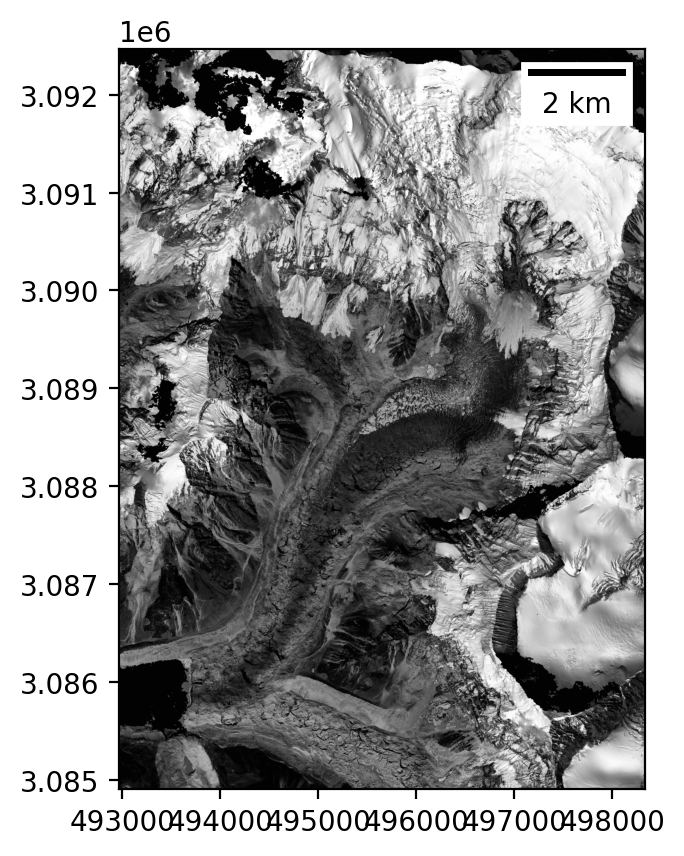

In [25]:
f,ax = plt.subplots()
#im2 = ax.imshow(norm(ortho_img, verbose=False,perc_lim=(10,90)), cmap='gray', extent=fig_extent, norm=LogNorm(vmin=0.01, vmax=1))
im2 = ax.imshow(exposure.equalize_adapthist(norm(ortho_img, verbose=False).data), cmap='gray', extent=fig_extent)
pltlib.add_scalebar(ax,res=2,location='upper right')

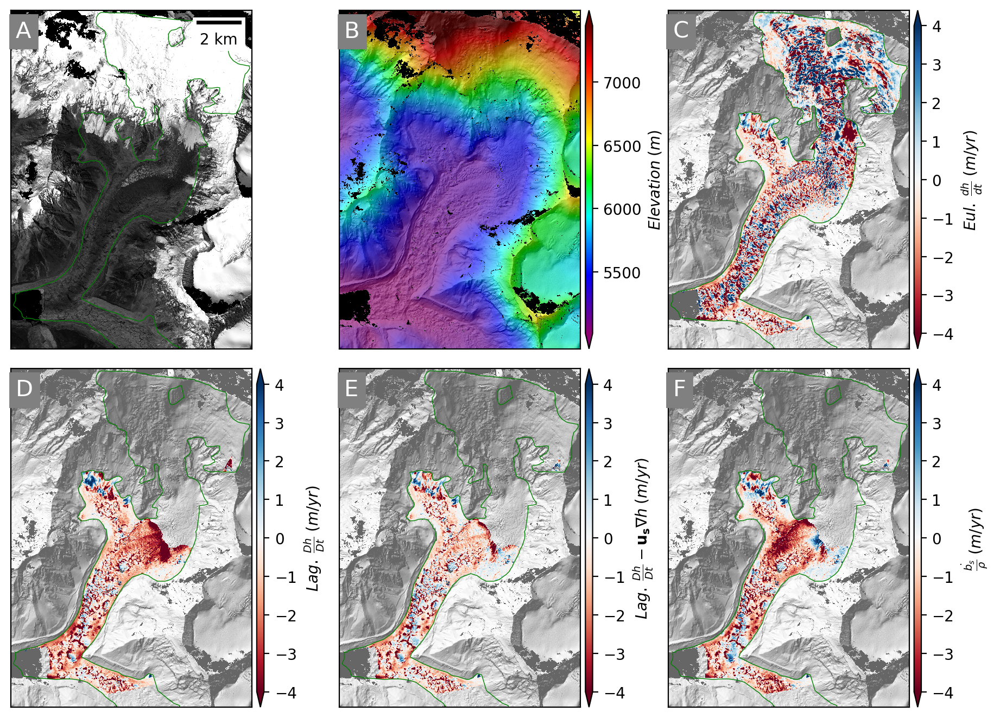

In [27]:
f,axa = plt.subplots(2,3,sharex=True,sharey=True,figsize=(9,8))
ax = axa.ravel()
pltlib.iv(ortho_img,ax=ax[0],cmap='gray',extent=fig_extent,skinny=False,cbar=False,clim=malib.calcperc(ortho_img,(0,80)))
pltlib.iv(dem1,ax=ax[1],hillshade=True,ds=ds_list[0],scalebar=False,extent=fig_extent,skinny=False,label='$Elevation \; (m)$',full_bg_stretch=True,overlay_alpha=0.6)
pltlib.add_scalebar(ax[0],res=2,location='upper right')
pltlib.iv(eul,ax=ax[2],cmap='RdBu',clim=(-4,4),hillshade=True,ds=ds_list[0],scalebar=False,extent=fig_extent,
          skinny=False,label=r'$Eul.\; \frac{dh}{dt} \; (m/yr)$',full_bg_stretch=False,overlay_alpha=1)
pltlib.iv(lag,ax=ax[3],cmap='RdBu',clim=(-4,4),hillshade=True,ds=ds_list[0],scalebar=False,extent=fig_extent,
          skinny=False,label=r'$Lag.\; \frac{Dh}{Dt} \; (m/yr)$',full_bg_stretch=False,overlay_alpha=1)
pltlib.iv(lag-slope_parallel,ax=ax[4],cmap='RdBu',clim=(-4,4),hillshade=True,ds=ds_list[0],scalebar=False,
          extent=fig_extent,skinny=False,label=r'$Lag. \; \frac{Dh}{Dt} - \mathbf{u_{s}}{\nabla h} \; (m/yr)$',full_bg_stretch=False,overlay_alpha=1)
pltlib.iv(smb,ax=ax[5],cmap='RdBu',clim=(-4,4),hillshade=True,ds=ds_list[0],scalebar=False,extent=fig_extent,
          skinny=False,label=r'$\frac{\dot{{b}_{s}}}{\rho}\;(m/yr)$ ',full_bg_stretch=False,overlay_alpha=1)
linewidth = 0.5
for idx,ax in enumerate(axa.ravel()):
    ax.set_xlim(fig_extent[0],fig_extent[1])
    ax.set_ylim(fig_extent[2],fig_extent[3])
    if idx == 1:
        continue
    else:
        glac_shp.plot(ax=ax,facecolor='None',edgecolor='green',linewidth=linewidth)
    ax.set_xlim(fig_extent[0],fig_extent[1])
    ax.set_ylim(fig_extent[2],fig_extent[3])
plt.tight_layout(pad=-0.1, w_pad=0.2, h_pad=0.05)
ax = axa.ravel()
t = ax[0].text(0.020,0.92,'A',
    color='white', fontsize=15,transform=ax[0].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))
t = ax[1].text(0.020,0.92,'B',
    color='white', fontsize=15,transform=ax[1].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))
t = ax[2].text(0.020,0.92,'C',
    color='white', fontsize=15,transform=ax[2].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))
t = ax[3].text(0.020,0.92,'D',
    color='white', fontsize=15,transform=ax[3].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))
t = ax[4].text(0.020,0.92,'E',
    color='white', fontsize=15,transform=ax[4].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))
t = ax[5].text(0.020,0.92,'F',
    color='white', fontsize=15,transform=ax[5].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))

f.savefig('figures/imja_smb_300_6panel.png',dpi=300,bbox_inches='tight',pad_inches=0.1)

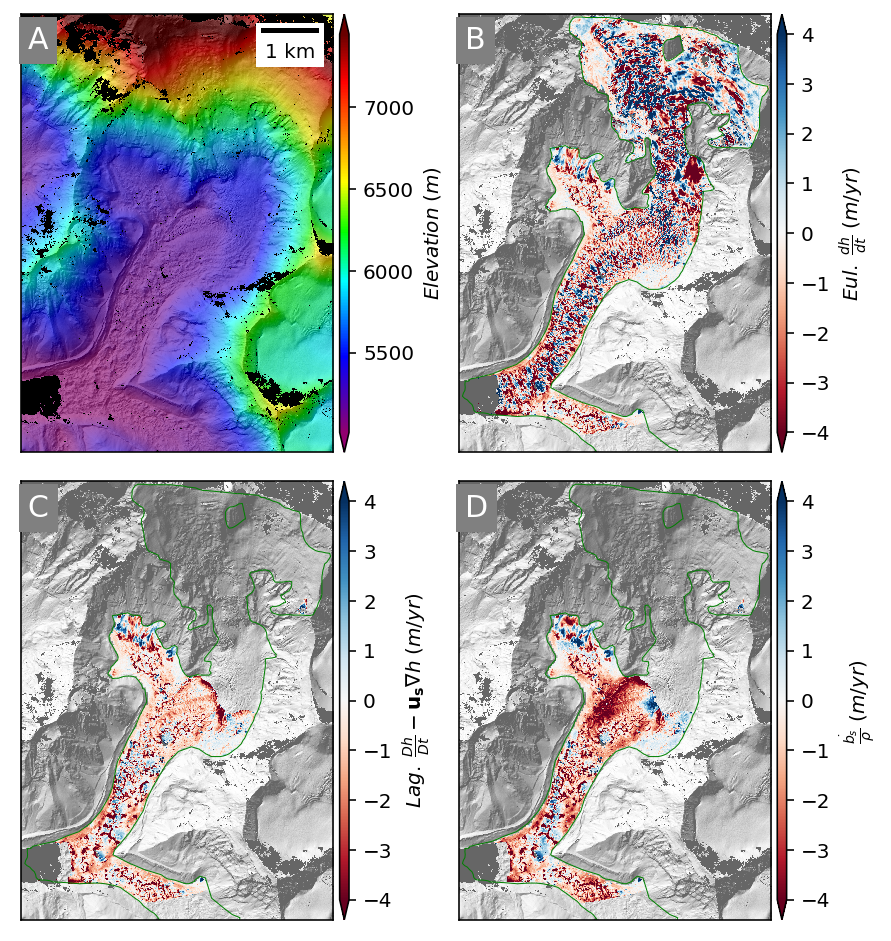

In [12]:
f,axa = plt.subplots(2,2,sharex=True,sharey=True,figsize=(6,8))
ax = axa.ravel()
pltlib.iv(dem1,ax=ax[0],hillshade=True,ds=ds_list[0],scalebar=False,extent=fig_extent,skinny=False,label='$Elevation \; (m)$',full_bg_stretch=True,overlay_alpha=0.6)
pltlib.add_scalebar(ax[0],res=1,location='upper right')
pltlib.iv(eul,ax=ax[1],cmap='RdBu',clim=(-4,4),hillshade=True,ds=ds_list[0],scalebar=False,extent=fig_extent,
          skinny=False,label=r'$Eul.\; \frac{dh}{dt} \; (m/yr)$',full_bg_stretch=False,overlay_alpha=1)
pltlib.iv(lag-slope_parallel,ax=ax[2],cmap='RdBu',clim=(-4,4),hillshade=True,ds=ds_list[0],scalebar=False,
          extent=fig_extent,skinny=False,label=r'$Lag. \; \frac{Dh}{Dt} - \mathbf{u_{s}}{\nabla h} \; (m/yr)$',full_bg_stretch=False,overlay_alpha=1)
pltlib.iv(smb,ax=ax[3],cmap='RdBu',clim=(-4,4),hillshade=True,ds=ds_list[0],scalebar=False,extent=fig_extent,
          skinny=False,label=r'$\frac{\dot{{b}_{s}}}{\rho}\;(m/yr)$ ',full_bg_stretch=False,overlay_alpha=1)
linewidth = 0.5
for idx,ax in enumerate(axa.ravel()):
    if idx == 0:
        continue
    else:
        glac_shp.plot(ax=ax,facecolor='None',edgecolor='green',linewidth=linewidth)
        ax.set_xlim(fig_extent[0],fig_extent[1])
        ax.set_ylim(fig_extent[2],fig_extent[3])
plt.tight_layout(pad=-0.1, w_pad=0.2, h_pad=0.05)
ax = axa.ravel()
t = ax[0].text(0.020,0.92,'A',
    color='white', fontsize=15,transform=ax[0].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))
t = ax[1].text(0.020,0.92,'B',
    color='white', fontsize=15,transform=ax[1].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))
t = ax[2].text(0.020,0.92,'C',
    color='white', fontsize=15,transform=ax[2].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))
t = ax[3].text(0.020,0.92,'D',
    color='white', fontsize=15,transform=ax[3].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))
f.savefig('figures/imja_smb_300.png',dpi=300,bbox_inches='tight',pad_inches=0.1)

In [18]:
ls /nobackupp11/sbhusha1/chapter2/figures/

SMB_maps.ipynb                   khumbu_vel_fluxdiv.png
blackchangrinup_vel_fluxdiv.png  langtang_vel_fluxdiv.png
imja_smb.png                     lirung_vel_fluxdiv.png
imja_vel_fluxdiv.png             ngozumpa_vel_fluxdiv.png


## 2. Ngozumpa

In [71]:
dem1_fn = 'ngozumpa/20121223_0456_1050410000E0AE00_1050410000E8C900-DEM_2m.tif'
eul_fn = 'ngozumpa/20230217/ngozumpa_farinotti_2012-12-23_to_2015-01-15_lag_smb_products/ngozumpa_farinotti_2012-12-23_to_2015-01-15_eulerian_dhdt.tif'
lag_fn = 'ngozumpa/20230217/ngozumpa_farinotti_2012-12-23_to_2015-01-15_lag_smb_products/ngozumpa_farinotti_2012-12-23_to_2015-01-15_lagrangian_dhdt.tif'
slope_parallel_fn = 'ngozumpa/20230217/ngozumpa_farinotti_2012-12-23_to_2015-01-15_lag_smb_products/ngozumpa_farinotti_2012-12-23_to_2015-01-15_downslope_dhdt.tif'
smb_fn = 'ngozumpa/20230217/ngozumpa_farinotti_2012-12-23_to_2015-01-15_lag_smb_products/ngozumpa_farinotti_2012-12-23_to_2015-01-15_smb_dhdt.tif'
glac_shp = gpd.read_file(constants.fetch_glac_shp(constants.rgi_dicts['ngozumpa'])).to_crs('EPSG:32645')
ortho_img_fn = 'ngozumpa/20230217/orthoimage/20121223_1050410000E0AE00_ortho_res_2.0m.tif'
ds_list = warplib.memwarp_multi_fn([dem1_fn,eul_fn,lag_fn,slope_parallel_fn,smb_fn,ortho_img_fn],res='last',r='average')

dem1,eul,lag,slope_parallel,smb,ortho_img = [iolib.ds_getma(ds) for ds in ds_list]
eul = velocity_timeseries.mask_by_shp(glac_shp.geometry,eul,ds=ds_list[1])
lag = velocity_timeseries.mask_by_shp(glac_shp.geometry,lag,ds=ds_list[2])
#vx = velocity_timeseries.mask_by_shp(glac_shp.geometry,iolib.ds_getma(vx_ds),vx_ds)
#vy = velocity_timeseries.mask_by_shp(glac_shp.geometry,iolib.ds_getma(vy_ds),vy_ds)
#divq2 = velocity_timeseries.mask_by_shp(glac_shp.geometry,divq2,ds_list[2])
res = geolib.get_res(ds_list[0])[0]
ds_extent = geolib.ds_extent(ds_list[0])
fig_extent = [ds_extent[0],ds_extent[2],ds_extent[1],ds_extent[3]]
contour_extent = [fig_extent[0],fig_extent[1],fig_extent[3],fig_extent[2]] # flip y axis otherwise contours are plotted flipped


Warping all inputs to the following:
Resolution: 2.0
Extent: [466125.0, 3089921.0, 476775.0, 3104071.0]
Projection: '+proj=utm +zone=45 +datum=WGS84 +units=m +no_defs'
Resampling alg: average

1 of 6: ngozumpa/20121223_0456_1050410000E0AE00_1050410000E8C900-DEM_2m.tif
nl: 7075 ns: 5325 res: 2.000
100 - done.
0...10...20...30...40...50...60...70...80...90...2 of 6: ngozumpa/20230217/ngozumpa_farinotti_2012-12-23_to_2015-01-15_lag_smb_products/ngozumpa_farinotti_2012-12-23_to_2015-01-15_eulerian_dhdt.tif
nl: 7075 ns: 5325 res: 2.000
100 - done.
0...10...20...30...40...50...60...70...80...90...3 of 6: ngozumpa/20230217/ngozumpa_farinotti_2012-12-23_to_2015-01-15_lag_smb_products/ngozumpa_farinotti_2012-12-23_to_2015-01-15_lagrangian_dhdt.tif
nl: 7075 ns: 5325 res: 2.000
100 - done.
0...10...20...30...40...50...60...70...80...90...4 of 6: ngozumpa/20230217/ngozumpa_farinotti_2012-12-23_to_2015-01-15_lag_smb_products/ngozumpa_farinotti_2012-12-23_to_2015-01-15_downslope_dhdt.tif
nl: 7075 n

### Check for mass conservation in Lagrangian corrections

In [72]:
mask = malib.common_mask([lag,slope_parallel,smb])

In [75]:
slope_corrected_lag_conservation = malib.get_stats_dict(np.ma.array(eul,mask=mask))['mean']-malib.get_stats_dict(np.ma.array(lag-slope_parallel,mask=mask))['mean']
print (f"Difference between Eul. dh/dt and slope-corrected Lag Dh/Dt for Ngozumpa Glacier is {np.round(slope_corrected_lag_conservation,2)} m/yr")

Difference between Eul. dh/dt and slope-corrected Lag Dh/Dt for Ngozumpa Glacier is 0.02 m/yr


In [73]:
malib.get_stats_dict(np.ma.array(eul,mask=mask))

{'count': 4840611,
 'min': -20.9544734954834,
 'max': 13.942404747009277,
 'ptp': 34.89687728881836,
 'mean': -0.9929635864268087,
 'std': 2.4220503147814627,
 'nmad': 1.5430110408782958,
 'med': -0.655767560005188,
 'median': -0.655767560005188,
 'p16': -2.8708784580230713,
 'p84': 0.7412921786308289,
 'spread': 1.80608531832695,
 'mode': -0.4946686029434204}

In [74]:
malib.get_stats_dict(np.ma.array(lag-slope_parallel,mask=mask))

{'count': 4851764,
 'min': -19.5518500874237,
 'max': 11.353064991849422,
 'ptp': 30.90491507927312,
 'mean': -1.0119472464347288,
 'std': 1.5958934519948553,
 'nmad': 1.0395148017176778,
 'med': -0.7100315321863041,
 'median': -0.7100315321863041,
 'p16': -2.1459073740360783,
 'p84': 0.15632314467659583,
 'spread': 1.1511152593563372,
 'mode': -1.037022282105763}

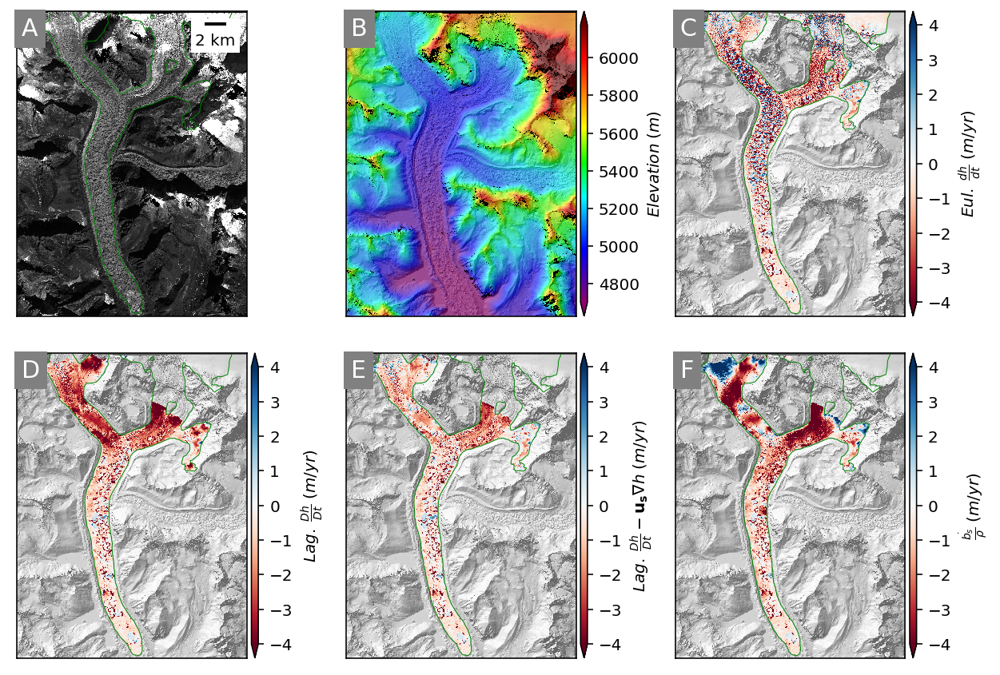

In [18]:
f,axa = plt.subplots(2,3,sharex=True,sharey=True,figsize=(8.5,8))
ax = axa.ravel()
pltlib.iv(ortho_img,ax=ax[0],cmap='gray',extent=fig_extent,skinny=False,cbar=False,clim=malib.calcperc(ortho_img,(0,95)))
#im2 = ax[0].imshow(exposure.equalize_adapthist(norm(ortho_img, verbose=False).data), cmap='gray', extent=fig_extent)
#ax[0].set_xticks([])
#ax[0].set_yticks([])
#pltlib.iv(exposure.equalize_adapthist(ortho_img),ax=ax[0],cmap='gray',
#          extent=fig_extent,skinny=False,cbar=False)
pltlib.iv(dem1,ax=ax[1],hillshade=True,ds=ds_list[0],scalebar=False,extent=fig_extent,skinny=False,label='$Elevation \; (m)$',full_bg_stretch=True,overlay_alpha=0.6)
pltlib.add_scalebar(ax[0],res=2,location='upper right')
pltlib.iv(eul,ax=ax[2],cmap='RdBu',clim=(-4,4),hillshade=True,ds=ds_list[0],scalebar=False,extent=fig_extent,
          skinny=False,label=r'$Eul.\; \frac{dh}{dt} \; (m/yr)$',full_bg_stretch=False,overlay_alpha=1)
pltlib.iv(lag,ax=ax[3],cmap='RdBu',clim=(-4,4),hillshade=True,ds=ds_list[0],scalebar=False,extent=fig_extent,
          skinny=False,label=r'$Lag.\; \frac{Dh}{Dt} \; (m/yr)$',full_bg_stretch=False,overlay_alpha=1)
pltlib.iv(lag-slope_parallel,ax=ax[4],cmap='RdBu',clim=(-4,4),hillshade=True,ds=ds_list[0],scalebar=False,
          extent=fig_extent,skinny=False,label=r'$Lag. \; \frac{Dh}{Dt} - \mathbf{u_{s}}{\nabla h} \; (m/yr)$',full_bg_stretch=False,overlay_alpha=1)
pltlib.iv(smb,ax=ax[5],cmap='RdBu',clim=(-4,4),hillshade=True,ds=ds_list[0],scalebar=False,extent=fig_extent,
          skinny=False,label=r'$\frac{\dot{{b}_{s}}}{\rho}\;(m/yr)$ ',full_bg_stretch=False,overlay_alpha=1)
linewidth = 0.5
for idx,ax in enumerate(axa.ravel()):
    ax.set_xlim(fig_extent[0],fig_extent[1])
    ax.set_ylim(fig_extent[2],fig_extent[3])
    if idx == 1:
        continue
    else:
        glac_shp.plot(ax=ax,facecolor='None',edgecolor='green',linewidth=linewidth)
    ax.set_xlim(fig_extent[0],fig_extent[1])
    ax.set_ylim(fig_extent[2],fig_extent[3])
plt.tight_layout(pad=-0.1, w_pad=0.2, h_pad=0.05)
ax = axa.ravel()
t = ax[0].text(0.020,0.92,'A',
    color='white', fontsize=15,transform=ax[0].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))
t = ax[1].text(0.020,0.92,'B',
    color='white', fontsize=15,transform=ax[1].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))
t = ax[2].text(0.020,0.92,'C',
    color='white', fontsize=15,transform=ax[2].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))
t = ax[3].text(0.020,0.92,'D',
    color='white', fontsize=15,transform=ax[3].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))
t = ax[4].text(0.020,0.92,'E',
    color='white', fontsize=15,transform=ax[4].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))
t = ax[5].text(0.020,0.92,'F',
    color='white', fontsize=15,transform=ax[5].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))

f.savefig('figures/ngozumpa_smb_300_6panel.png',dpi=300,bbox_inches='tight',pad_inches=0.1)

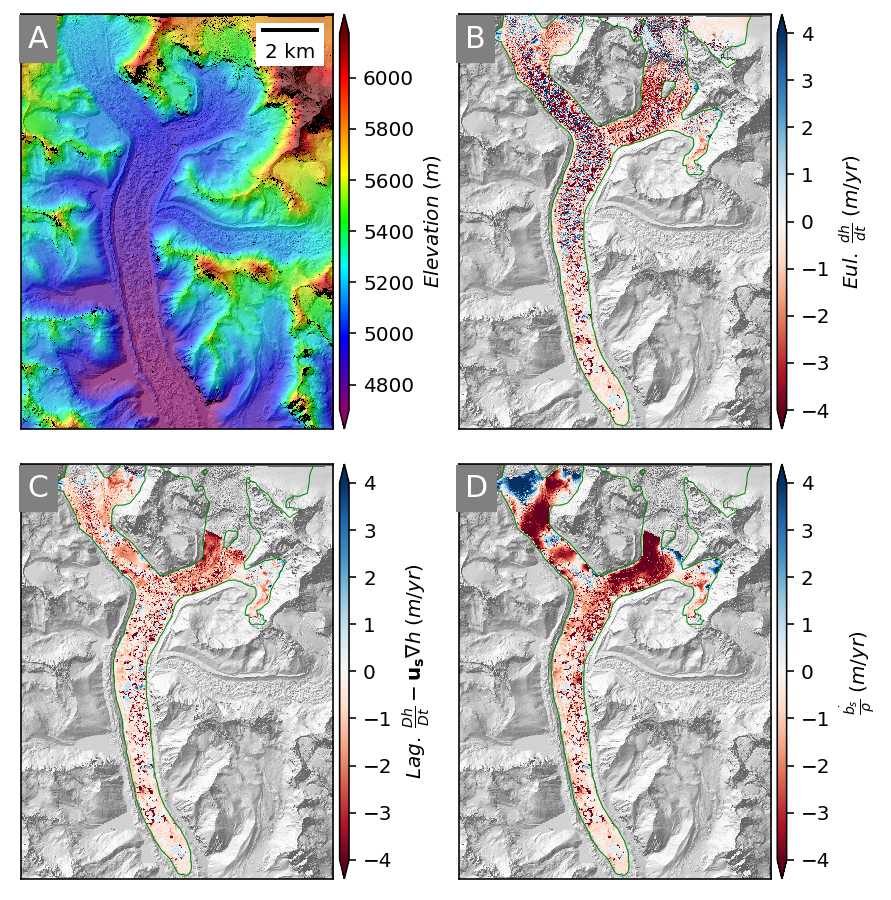

In [20]:
f,axa = plt.subplots(2,2,sharex=True,sharey=True,figsize=(6,8))
ax = axa.ravel()
pltlib.iv(dem1,ax=ax[0],hillshade=True,ds=ds_list[0],scalebar=False,extent=fig_extent,skinny=False,label='$Elevation \; (m)$',full_bg_stretch=True,overlay_alpha=0.6)
pltlib.add_scalebar(ax[0],res=1,location='upper right')
pltlib.iv(eul,ax=ax[1],cmap='RdBu',clim=(-4,4),hillshade=True,ds=ds_list[0],scalebar=False,extent=fig_extent,
          skinny=False,label=r'$Eul.\; \frac{dh}{dt} \; (m/yr)$',full_bg_stretch=False,overlay_alpha=1)
pltlib.iv(lag-slope_parallel,ax=ax[2],cmap='RdBu',clim=(-4,4),hillshade=True,ds=ds_list[0],scalebar=False,
          extent=fig_extent,skinny=False,label=r'$Lag. \; \frac{Dh}{Dt} - \mathbf{u_{s}}{\nabla h} \; (m/yr)$',full_bg_stretch=False,overlay_alpha=1)
pltlib.iv(smb,ax=ax[3],cmap='RdBu',clim=(-4,4),hillshade=True,ds=ds_list[0],scalebar=False,extent=fig_extent,
          skinny=False,label=r'$\frac{\dot{{b}_{s}}}{\rho}\;(m/yr)$ ',full_bg_stretch=False,overlay_alpha=1)
linewidth = 0.5
for idx,ax in enumerate(axa.ravel()):
    if idx == 0:
        continue
    else:
        glac_shp.plot(ax=ax,facecolor='None',edgecolor='green',linewidth=linewidth)
        ax.set_xlim(fig_extent[0],fig_extent[1])
        ax.set_ylim(fig_extent[2],fig_extent[3])
plt.tight_layout(pad=-0.1, w_pad=0.2, h_pad=0.05)
ax = axa.ravel()
t = ax[0].text(0.020,0.92,'A',
    color='white', fontsize=15,transform=ax[0].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))
t = ax[1].text(0.020,0.92,'B',
    color='white', fontsize=15,transform=ax[1].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))
t = ax[2].text(0.020,0.92,'C',
    color='white', fontsize=15,transform=ax[2].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))
t = ax[3].text(0.020,0.92,'D',
    color='white', fontsize=15,transform=ax[3].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))
f.savefig('figures/ngozumpa_smb.png',dpi=300,bbox_inches='tight',pad_inches=0.1)

## 3. Black Changri Nup 

In [102]:
dem1_fn = 'changrinup/20151102_aligned/20151102_aligned-trans_source-DEM.tif'
eul_fn = 'changrinup/20230217/black_changri_nup_2015-11-02_to_2016-10-25_lag_smb_products/black_changri_nup_2015-11-02_to_2016-10-25_eulerian_dhdt.tif'
lag_fn = 'changrinup/20230217/black_changri_nup_2015-11-02_to_2016-10-25_lag_smb_products/black_changri_nup_2015-11-02_to_2016-10-25_lagrangian_dhdt.tif'
slope_parallel_fn = 'changrinup/20230217/black_changri_nup_2015-11-02_to_2016-10-25_lag_smb_products/black_changri_nup_2015-11-02_to_2016-10-25_downslope_dhdt.tif'
smb_fn = 'changrinup/20230217/black_changri_nup_2015-11-02_to_2016-10-25_lag_smb_products/black_changri_nup_2015-11-02_to_2016-10-25_smb_dhdt.tif'
ortho_img_fn = 'changrinup/20230217/orthoimage/20151102_10400100125E8E00_ortho_res_2.0m.tif'
glac_shp = gpd.read_file('/nobackup/sbhusha1/hma/agu22_scratch/Black_changri_with_accumulation_area2.shp') 
ds_list = warplib.memwarp_multi_fn([dem1_fn,eul_fn,lag_fn,slope_parallel_fn,ortho_img_fn,smb_fn],res='last',r='cubic')

dem1,eul,lag,slope_parallel,ortho_img,smb = [iolib.ds_getma(ds) for ds in ds_list]
eul = velocity_timeseries.mask_by_shp(glac_shp.geometry,eul,ds=ds_list[1])
lag = velocity_timeseries.mask_by_shp(glac_shp.geometry,lag,ds=ds_list[1])
#vx = velocity_timeseries.mask_by_shp(glac_shp.geometry,iolib.ds_getma(vx_ds),vx_ds)
#vy = velocity_timeseries.mask_by_shp(glac_shp.geometry,iolib.ds_getma(vy_ds),vy_ds)
#divq2 = velocity_timeseries.mask_by_shp(glac_shp.geometry,divq2,ds_list[2])
res = geolib.get_res(ds_list[0])[0]
ds_extent = geolib.ds_extent(ds_list[0])
fig_extent = [ds_extent[0],ds_extent[2],ds_extent[1],ds_extent[3]]
contour_extent = [fig_extent[0],fig_extent[1],fig_extent[3],fig_extent[2]] # flip y axis otherwise contours are plotted flipped


Warping all inputs to the following:
Resolution: 2.0
Extent: [476612.5, 3094162.5, 482987.5, 3099437.5]
Projection: '+proj=utm +zone=45 +datum=WGS84 +units=m +no_defs'
Resampling alg: cubic

1 of 6: changrinup/20151102_aligned/20151102_aligned-trans_source-DEM.tif
nl: 2638 ns: 3188 res: 2.000
100 - done.
0...10...20...30...40...50...60...70...80...90...2 of 6: changrinup/20230217/black_changri_nup_2015-11-02_to_2016-10-25_lag_smb_products/black_changri_nup_2015-11-02_to_2016-10-25_eulerian_dhdt.tif
nl: 2638 ns: 3188 res: 2.000
100 - done.
0...10...20...30...40...50...60...70...80...90...3 of 6: changrinup/20230217/black_changri_nup_2015-11-02_to_2016-10-25_lag_smb_products/black_changri_nup_2015-11-02_to_2016-10-25_lagrangian_dhdt.tif
nl: 2638 ns: 3188 res: 2.000
100 - done.
0...10...20...30...40...50...60...70...80...90...4 of 6: changrinup/20230217/black_changri_nup_2015-11-02_to_2016-10-25_lag_smb_products/black_changri_nup_2015-11-02_to_2016-10-25_downslope_dhdt.tif
nl: 2638 ns: 3

### Check for mass conservation in Lagrangian corrections

In [103]:
mask = malib.common_mask([lag,slope_parallel,smb])

In [104]:
malib.get_stats_dict(np.ma.array(eul,mask=mask))

{'count': 529274,
 'min': -17.613584518432617,
 'max': 17.609821319580078,
 'ptp': 35.22340393066406,
 'mean': -0.5842081771191416,
 'std': 1.763680234058044,
 'nmad': 0.8780716460287571,
 'med': -0.5363467633724213,
 'median': -0.5363467633724213,
 'p16': -1.60456250667572,
 'p84': 0.34088157773017885,
 'spread': 0.9727220422029494,
 'mode': -1.669399619102478}

In [105]:
malib.get_stats_dict(np.ma.array(lag-slope_parallel,mask=mask))

{'count': 529476,
 'min': -17.10027255898622,
 'max': 17.384774957508075,
 'ptp': 34.48504751649429,
 'mean': -0.5914724529109737,
 'std': 1.477629678964617,
 'nmad': 0.7014688987760218,
 'med': -0.5254128230357171,
 'median': -0.5254128230357171,
 'p16': -1.384359361480545,
 'p84': 0.1577079842467377,
 'spread': 0.7710336728636413,
 'mode': -17.10027255898622}

In [106]:
malib.get_stats_dict(np.ma.array(smb,mask=mask))

{'count': 529476,
 'min': -17.2229925968912,
 'max': 17.726556462591866,
 'ptp': 34.94954905948306,
 'mean': -0.6158304768820692,
 'std': 1.8491107176626669,
 'nmad': 0.9644326900922118,
 'med': -0.6896414461278318,
 'median': -0.6896414461278318,
 'p16': -1.7017404945706511,
 'p84': 0.3150009488587193,
 'spread': 1.0083707217146851,
 'mode': -17.2229925968912}

In [107]:
slope_corrected_lag_conservation = malib.get_stats_dict(np.ma.array(eul,mask=mask))['mean']-malib.get_stats_dict(np.ma.array(lag-slope_parallel,mask=mask))['mean']
print (f"Difference between Eul. dh/dt and slope-corrected Lag Dh/Dt for Black Changri Nup Glacier is {np.round(slope_corrected_lag_conservation,2)} m/yr")

Difference between Eul. dh/dt and slope-corrected Lag Dh/Dt for Black Changri Nup Glacier is 0.01 m/yr


In [108]:
slope_corrected_lag_smb_conservation = malib.get_stats_dict(np.ma.array(eul,mask=mask))['mean']-malib.get_stats_dict(np.ma.array(smb,mask=mask))['mean']
print (f"Difference between Eul. dh/dt and Lag. SMB for Black Changri Nup Glacier is {np.round(slope_corrected_lag_smb_conservation,2)} m/yr")

Difference between Eul. dh/dt and Lag. SMB for Black Changri Nup Glacier is 0.03 m/yr


In [39]:
! apply_mask.py changrinup/20230217/black_changri_nup_2015-11-02_to_2016-10-25_lag_smb_products/black_changri_nup_2015-11-02_to_2016-10-25_smb_dhdt.tif /nobackupp11/sbhusha1/hma/lagdz_samples/debris_thickness/HMA_DTE_15.03734_hdts_m.tif

Warping mask_fn

Warping all inputs to the following:
Resolution: 2.0
Extent: [474665.0, 3090517.0, 488435.0, 3100917.0]
Projection: '+proj=utm +zone=45 +datum=WGS84 +units=m +no_defs'
Resampling alg: cubic

1 of 1: /nobackupp11/sbhusha1/hma/lagdz_samples/debris_thickness/HMA_DTE_15.03734_hdts_m.tif
nl: 5200 ns: 6885 res: 2.000
0...10...20...30...40...50...60...70...80...90...100 - done.
Loading mask array
Extracting mask
Loading src array and applying updated mask
Writing out masked version of input raster: changrinup/20230217/black_changri_nup_2015-11-02_to_2016-10-25_lag_smb_products/black_changri_nup_2015-11-02_to_2016-10-25_smb_dhdt_masked.tif
swig/python detected a memory leak of type 'OSRSpatialReferenceShadow *', no destructor found.
swig/python detected a memory leak of type 'OSRSpatialReferenceShadow *', no destructor found.
swig/python detected a memory leak of type 'OSRSpatialReferenceShadow *', no destructor found.
swig/python detected a memory leak of type 'OSRSpatialRefe

In [40]:
! robust_stats.py changrinup/20230217/black_changri_nup_2015-11-02_to_2016-10-25_lag_smb_products/black_changri_nup_2015-11-02_to_2016-10-25_smb_dhdt_masked.tif

/swbuild/sbhusha1/miniconda3/envs/bhushanGDAL3/lib/python3.9/site-packages/osgeo/gdal.py:287: FutureWarning: Neither gdal.UseExceptions() nor gdal.DontUseExceptions() has been explicitly called. In GDAL 4.0, exceptions will be enabled by default.
  warnings.warn(
Count: 286436
RMSE: 1.734
Mean Error: -1.178
Standard Deviation: 1.272
Median Error: -0.980
16th Percentile: -1.905
84th Percentile: -0.266
Spread: 1.638
Absolute Median Error: 0.991
NMAD: 0.801
68.3th Percentile: 1.397
95th Percentile: 3.267


In [41]:
constants.fetch_rounce_debris_thickness('changri_nup')

'/nobackupp11/sbhusha1/hma/lagdz_samples/debris_thickness/HMA_DTE_15.03734_hdts_m.tif'

In [48]:
%matplotlib inline

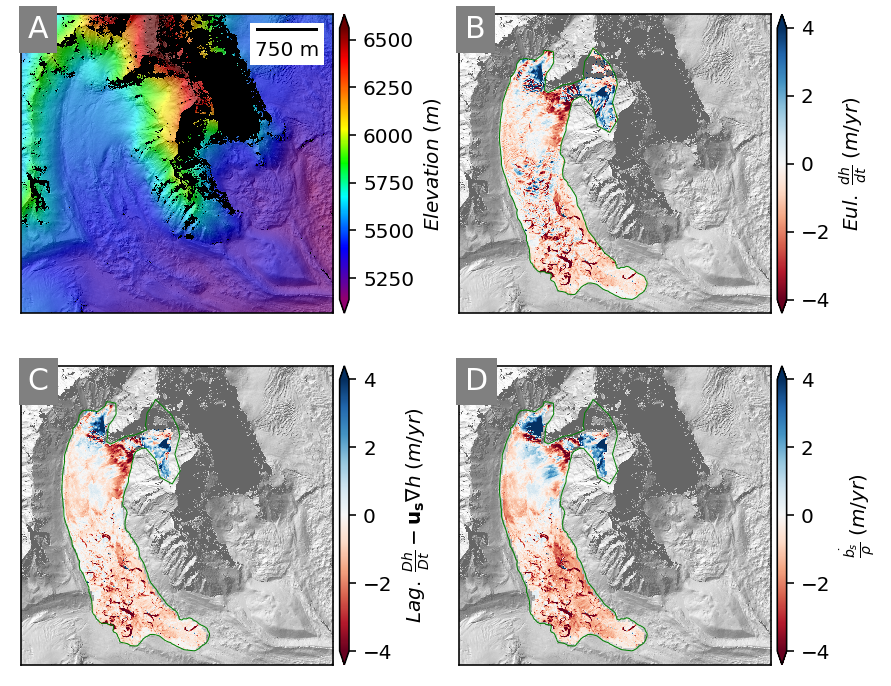

In [37]:
f,axa = plt.subplots(2,2,sharex=True,sharey=True,figsize=(6,8))
ax = axa.ravel()
pltlib.iv(dem1,ax=ax[0],hillshade=True,ds=ds_list[0],scalebar=False,extent=fig_extent,skinny=False,label='$Elevation \; (m)$',full_bg_stretch=True,overlay_alpha=0.6)
pltlib.add_scalebar(ax[0],res=1,location='upper right')
pltlib.iv(eul,ax=ax[1],cmap='RdBu',clim=(-4,4),hillshade=True,ds=ds_list[0],scalebar=False,extent=fig_extent,
          skinny=False,label=r'$Eul.\; \frac{dh}{dt} \; (m/yr)$',full_bg_stretch=False,overlay_alpha=1)
pltlib.iv(lag-slope_parallel,ax=ax[2],cmap='RdBu',clim=(-4,4),hillshade=True,ds=ds_list[0],scalebar=False,
          extent=fig_extent,skinny=False,label=r'$Lag. \; \frac{Dh}{Dt} - \mathbf{u_{s}}{\nabla h} \; (m/yr)$',full_bg_stretch=False,overlay_alpha=1)
pltlib.iv(smb,ax=ax[3],cmap='RdBu',clim=(-4,4),hillshade=True,ds=ds_list[0],scalebar=False,extent=fig_extent,
          skinny=False,label=r'$\frac{\dot{{b}_{s}}}{\rho}\;(m/yr)$ ',full_bg_stretch=False,overlay_alpha=1)
linewidth = 0.5
for idx,ax in enumerate(axa.ravel()):
    if idx == 0:
        continue
    else:
        glac_shp.plot(ax=ax,facecolor='None',edgecolor='green',linewidth=linewidth)
        ax.set_xlim(477599.7040301451, 481379.6298482157)
        ax.set_ylim(3094811.880500241, 3098430.95841116)
plt.tight_layout(pad=-0.1, w_pad=0.2, h_pad=0.05)
ax = axa.ravel()
t = ax[0].text(0.020,0.92,'A',
    color='white', fontsize=15,transform=ax[0].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))
t = ax[1].text(0.020,0.92,'B',
    color='white', fontsize=15,transform=ax[1].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))
t = ax[2].text(0.020,0.92,'C',
    color='white', fontsize=15,transform=ax[2].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))
t = ax[3].text(0.020,0.92,'D',
    color='white', fontsize=15,transform=ax[3].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))
f.savefig('figures/blackchangri_smb.png',dpi=300,bbox_inches='tight',pad_inches=0.1)

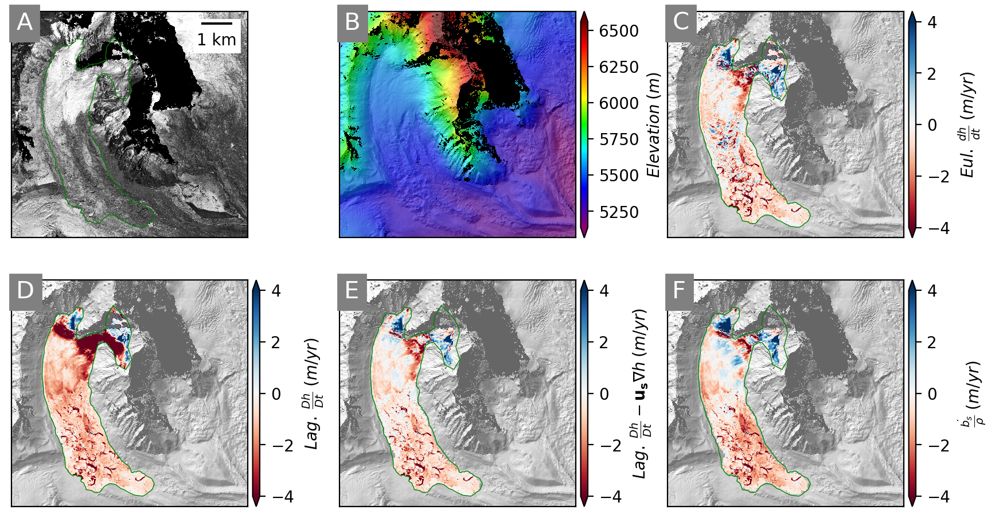

In [42]:
f,axa = plt.subplots(2,3,sharex=True,sharey=True,figsize=(8.5,8))
ax = axa.ravel()
pltlib.iv(ortho_img,ax=ax[0],cmap='gray',extent=fig_extent,skinny=False,cbar=False,clim=malib.calcperc(ortho_img,(0,95)))
#im2 = ax[0].imshow(exposure.equalize_adapthist(norm(ortho_img, verbose=False).data), cmap='gray', extent=fig_extent)
#ax[0].set_xticks([])
#ax[0].set_yticks([])
#pltlib.iv(exposure.equalize_adapthist(ortho_img),ax=ax[0],cmap='gray',
#          extent=fig_extent,skinny=False,cbar=False)
pltlib.iv(dem1,ax=ax[1],hillshade=True,ds=ds_list[0],scalebar=False,extent=fig_extent,skinny=False,label='$Elevation \; (m)$',full_bg_stretch=True,overlay_alpha=0.6)
pltlib.add_scalebar(ax[0],res=2,location='upper right')
pltlib.iv(eul,ax=ax[2],cmap='RdBu',clim=(-4,4),hillshade=True,ds=ds_list[0],scalebar=False,extent=fig_extent,
          skinny=False,label=r'$Eul.\; \frac{dh}{dt} \; (m/yr)$',full_bg_stretch=False,overlay_alpha=1)
pltlib.iv(lag,ax=ax[3],cmap='RdBu',clim=(-4,4),hillshade=True,ds=ds_list[0],scalebar=False,extent=fig_extent,
          skinny=False,label=r'$Lag.\; \frac{Dh}{Dt} \; (m/yr)$',full_bg_stretch=False,overlay_alpha=1)
pltlib.iv(lag-slope_parallel,ax=ax[4],cmap='RdBu',clim=(-4,4),hillshade=True,ds=ds_list[0],scalebar=False,
          extent=fig_extent,skinny=False,label=r'$Lag. \; \frac{Dh}{Dt} - \mathbf{u_{s}}{\nabla h} \; (m/yr)$',full_bg_stretch=False,overlay_alpha=1)
pltlib.iv(smb,ax=ax[5],cmap='RdBu',clim=(-4,4),hillshade=True,ds=ds_list[0],scalebar=False,extent=fig_extent,
          skinny=False,label=r'$\frac{\dot{{b}_{s}}}{\rho}\;(m/yr)$ ',full_bg_stretch=False,overlay_alpha=1)
linewidth = 0.5
for idx,ax in enumerate(axa.ravel()):
    
    if idx == 1:
        continue
    else:
        
        glac_shp.plot(ax=ax,facecolor='None',edgecolor='green',linewidth=linewidth)
    ax.set_xlim(477599.7040301451, 481379.6298482157)
    ax.set_ylim(3094811.880500241, 3098430.95841116)
    
plt.tight_layout(pad=-0.1, w_pad=0.2, h_pad=0.05)
ax = axa.ravel()
t = ax[0].text(0.020,0.92,'A',
    color='white', fontsize=15,transform=ax[0].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))
t = ax[1].text(0.020,0.92,'B',
    color='white', fontsize=15,transform=ax[1].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))
t = ax[2].text(0.020,0.92,'C',
    color='white', fontsize=15,transform=ax[2].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))
t = ax[3].text(0.020,0.92,'D',
    color='white', fontsize=15,transform=ax[3].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))
t = ax[4].text(0.020,0.92,'E',
    color='white', fontsize=15,transform=ax[4].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))
t = ax[5].text(0.020,0.92,'F',
    color='white', fontsize=15,transform=ax[5].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))

f.savefig('figures/changri_nup_smb_300_6panel.png',dpi=300,bbox_inches='tight',pad_inches=0.1)

f,axa = plt.subplots(2,2,sharex=True,sharey=True,figsize=(5,6))
ax = axa.ravel()
pltlib.iv(dem1,ax=ax[0],hillshade=True,ds=ds_list[0],scalebar=False,extent=fig_extent,skinny=False,label='Elevation (m)')
pltlib.add_scalebar(ax[0],res=1,location='upper right')
pltlib.iv(eul,ax=ax[1],cmap='RdBu',clim=(-4,4),hillshade=True,ds=ds_list[0],scalebar=False,extent=fig_extent,skinny=False,label=r'$\frac{dh}{dt}$'+' (m/yr)')
pltlib.iv(lag-slope_parallel,ax=ax[2],cmap='RdBu',clim=(-4,4),hillshade=True,ds=ds_list[0],scalebar=False,extent=fig_extent,skinny=False,label=r'$\frac{Dh}{Dt} - \mathbf{u_{s}}{\nabla h}$'+' (m/yr)')
pltlib.iv(smb,ax=ax[3],cmap='RdBu',clim=(-4,4),hillshade=True,ds=ds_list[0],scalebar=False,extent=fig_extent,skinny=False,label=r'$\frac{\dot{{b}_{s}}}{\rho}$'+' (m i.e./yr)')
linewidth = 1
for ax in axa.ravel():

    glac_shp.plot(ax=ax,facecolor='None',edgecolor='black',linewidth=linewidth)
    ax.set_xlim(477599.7040301451, 481379.6298482157)
    ax.set_ylim(3094811.880500241, 3098430.95841116)
plt.tight_layout()
f.savefig('figures/blackchangri_smb.png',dpi=300,bbox_inches='tight',pad_inches=0.1)

In [42]:
ax.get_xlim()

(477599.7040301451, 481379.6298482157)

In [43]:
ax.get_ylim()

(3094811.880500241, 3098430.95841116)

## 4. Khumbu

In [109]:
dem1_fn = 'changrinup/20151102_aligned/20151102_aligned-trans_source-DEM.tif'
eul_fn = 'changrinup/20230217/khumbu_farinotti_2015-11-02_to_2016-10-25_lag_smb_products/khumbu_farinotti_2015-11-02_to_2016-10-25_eulerian_dhdt.tif'
lag_fn = 'changrinup/20230217/khumbu_farinotti_2015-11-02_to_2016-10-25_lag_smb_products/khumbu_farinotti_2015-11-02_to_2016-10-25_lagrangian_dhdt.tif'
slope_parallel_fn = 'changrinup/20230217/khumbu_farinotti_2015-11-02_to_2016-10-25_lag_smb_products/khumbu_farinotti_2015-11-02_to_2016-10-25_downslope_dhdt.tif'
smb_fn = 'changrinup/20230217/khumbu_farinotti_2015-11-02_to_2016-10-25_lag_smb_products/khumbu_farinotti_2015-11-02_to_2016-10-25_smb_dhdt.tif'
ortho_img_fn = 'changrinup/20230217/orthoimage/20151102_10400100125E8E00_ortho_res_2.0m.tif'
glac_shp = gpd.read_file(constants.fetch_glac_shp(constants.rgi_dicts['khumbu'])).to_crs('EPSG:32645')
ds_list = warplib.memwarp_multi_fn([dem1_fn,eul_fn,lag_fn,slope_parallel_fn,smb_fn,ortho_img_fn],res='last',r='average')

dem1,eul,lag,slope_parallel,smb,ortho_img = [iolib.ds_getma(ds) for ds in ds_list]
eul = velocity_timeseries.mask_by_shp(glac_shp.geometry,eul,ds=ds_list[1])
lag = velocity_timeseries.mask_by_shp(glac_shp.geometry,lag,ds=ds_list[1])
#vx = velocity_timeseries.mask_by_shp(glac_shp.geometry,iolib.ds_getma(vx_ds),vx_ds)
#vy = velocity_timeseries.mask_by_shp(glac_shp.geometry,iolib.ds_getma(vy_ds),vy_ds)
#divq2 = velocity_timeseries.mask_by_shp(glac_shp.geometry,divq2,ds_list[2])
res = geolib.get_res(ds_list[0])[0]
ds_extent = geolib.ds_extent(ds_list[0])
fig_extent = [ds_extent[0],ds_extent[2],ds_extent[1],ds_extent[3]]
contour_extent = [fig_extent[0],fig_extent[1],fig_extent[3],fig_extent[2]] # flip y axis otherwise contours are plotted flipped


Warping all inputs to the following:
Resolution: 2.0
Extent: [481512.5, 3090519.0, 488435.0, 3099662.5]
Projection: '+proj=utm +zone=45 +datum=WGS84 +units=m +no_defs'
Resampling alg: average

1 of 6: changrinup/20151102_aligned/20151102_aligned-trans_source-DEM.tif
nl: 4572 ns: 3461 res: 2.000
100 - done.
0...10...20...30...40...50...60...70...80...90...2 of 6: changrinup/20230217/khumbu_farinotti_2015-11-02_to_2016-10-25_lag_smb_products/khumbu_farinotti_2015-11-02_to_2016-10-25_eulerian_dhdt.tif
nl: 4572 ns: 3461 res: 2.000
100 - done.
0...10...20...30...40...50...60...70...80...90...3 of 6: changrinup/20230217/khumbu_farinotti_2015-11-02_to_2016-10-25_lag_smb_products/khumbu_farinotti_2015-11-02_to_2016-10-25_lagrangian_dhdt.tif
nl: 4572 ns: 3461 res: 2.000
100 - done.
0...10...20...30...40...50...60...70...80...90...4 of 6: changrinup/20230217/khumbu_farinotti_2015-11-02_to_2016-10-25_lag_smb_products/khumbu_farinotti_2015-11-02_to_2016-10-25_downslope_dhdt.tif
nl: 4572 ns: 3461 

### Check for mass conservation in Lagrangian corrections

In [110]:
mask = malib.common_mask([lag,slope_parallel,smb])


In [111]:
slope_corrected_lag_conservation = malib.get_stats_dict(np.ma.array(eul,mask=mask))['mean']-malib.get_stats_dict(np.ma.array(lag-slope_parallel,mask=mask))['mean']
print (f"Difference between Eul. dh/dt and slope-corrected Lag Dh/Dt for Khumbu Glacier is {np.round(slope_corrected_lag_conservation,2)} m/yr")

Difference between Eul. dh/dt and slope-corrected Lag Dh/Dt for Khumbu Glacier is 0.09 m/yr


In [85]:
malib.get_stats_dict(np.ma.array(lag-slope_parallel,mask=mask))

{'count': 2054092,
 'min': -33.26750468423944,
 'max': 21.32819679172387,
 'ptp': 54.59570147596331,
 'mean': -1.1015424241599443,
 'std': 1.9898627976782663,
 'nmad': 1.3032789491834087,
 'med': -0.7736932794308529,
 'median': -0.7736932794308529,
 'p16': -2.446649327887503,
 'p84': 0.3067573168513744,
 'spread': 1.3767033223694387,
 'mode': -12.875121515465045}

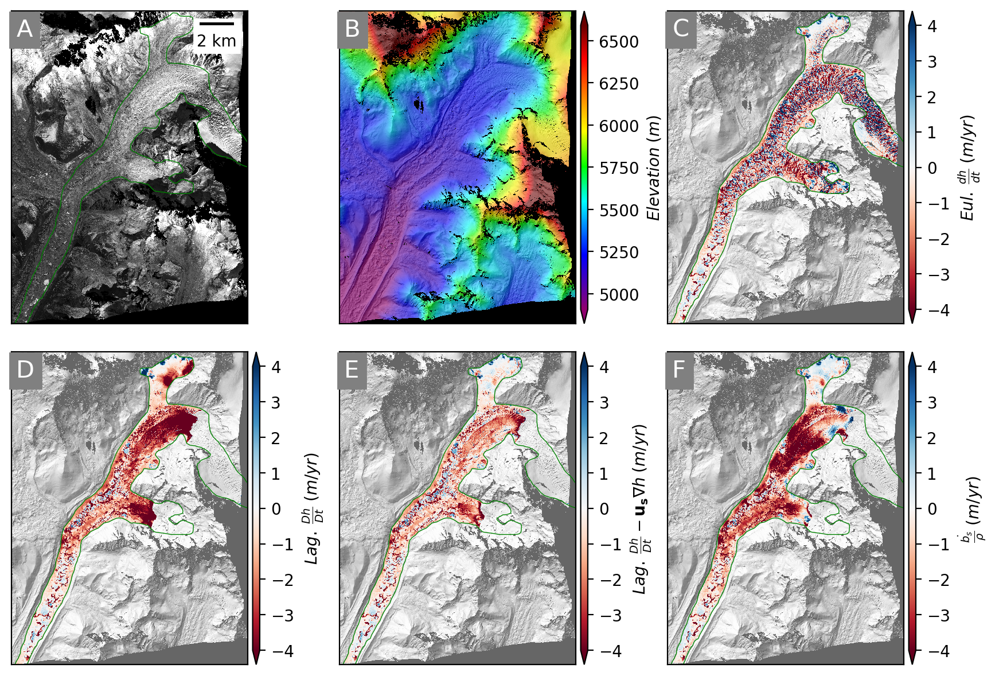

In [51]:
f,axa = plt.subplots(2,3,sharex=True,sharey=True,figsize=(8.5,8))
ax = axa.ravel()
pltlib.iv(ortho_img,ax=ax[0],cmap='gray',extent=fig_extent,skinny=False,cbar=False,clim=malib.calcperc(ortho_img,(0,95)))
#im2 = ax[0].imshow(exposure.equalize_adapthist(norm(ortho_img, verbose=False).data), cmap='gray', extent=fig_extent)
#ax[0].set_xticks([])
#ax[0].set_yticks([])
#pltlib.iv(exposure.equalize_adapthist(ortho_img),ax=ax[0],cmap='gray',
#          extent=fig_extent,skinny=False,cbar=False)
pltlib.iv(dem1,ax=ax[1],hillshade=True,ds=ds_list[0],scalebar=False,extent=fig_extent,skinny=False,label='$Elevation \; (m)$',full_bg_stretch=True,overlay_alpha=0.6)
pltlib.add_scalebar(ax[0],res=2,location='upper right')
pltlib.iv(eul,ax=ax[2],cmap='RdBu',clim=(-4,4),hillshade=True,ds=ds_list[0],scalebar=False,extent=fig_extent,
          skinny=False,label=r'$Eul.\; \frac{dh}{dt} \; (m/yr)$',full_bg_stretch=False,overlay_alpha=1)
pltlib.iv(lag,ax=ax[3],cmap='RdBu',clim=(-4,4),hillshade=True,ds=ds_list[0],scalebar=False,extent=fig_extent,
          skinny=False,label=r'$Lag.\; \frac{Dh}{Dt} \; (m/yr)$',full_bg_stretch=False,overlay_alpha=1)
pltlib.iv(lag-slope_parallel,ax=ax[4],cmap='RdBu',clim=(-4,4),hillshade=True,ds=ds_list[0],scalebar=False,
          extent=fig_extent,skinny=False,label=r'$Lag. \; \frac{Dh}{Dt} - \mathbf{u_{s}}{\nabla h} \; (m/yr)$',full_bg_stretch=False,overlay_alpha=1)
pltlib.iv(smb,ax=ax[5],cmap='RdBu',clim=(-4,4),hillshade=True,ds=ds_list[0],scalebar=False,extent=fig_extent,
          skinny=False,label=r'$\frac{\dot{{b}_{s}}}{\rho}\;(m/yr)$ ',full_bg_stretch=False,overlay_alpha=1)
linewidth = 0.5
for idx,ax in enumerate(axa.ravel()):
    ax.set_xlim(fig_extent[0],fig_extent[1])
    ax.set_ylim(fig_extent[2],fig_extent[3])
    if idx == 1:
        continue
    else:
        glac_shp.plot(ax=ax,facecolor='None',edgecolor='green',linewidth=linewidth)
    ax.set_xlim(fig_extent[0],fig_extent[1])
    ax.set_ylim(fig_extent[2],fig_extent[3])
plt.tight_layout(pad=-0.1, w_pad=0.2, h_pad=0.05)
ax = axa.ravel()
t = ax[0].text(0.020,0.92,'A',
    color='white', fontsize=15,transform=ax[0].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))
t = ax[1].text(0.020,0.92,'B',
    color='white', fontsize=15,transform=ax[1].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))
t = ax[2].text(0.020,0.92,'C',
    color='white', fontsize=15,transform=ax[2].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))
t = ax[3].text(0.020,0.92,'D',
    color='white', fontsize=15,transform=ax[3].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))
t = ax[4].text(0.020,0.92,'E',
    color='white', fontsize=15,transform=ax[4].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))
t = ax[5].text(0.020,0.92,'F',
    color='white', fontsize=15,transform=ax[5].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))

f.savefig('figures/khumbu_smb_300_6panel.png',dpi=300,bbox_inches='tight',pad_inches=0.1)

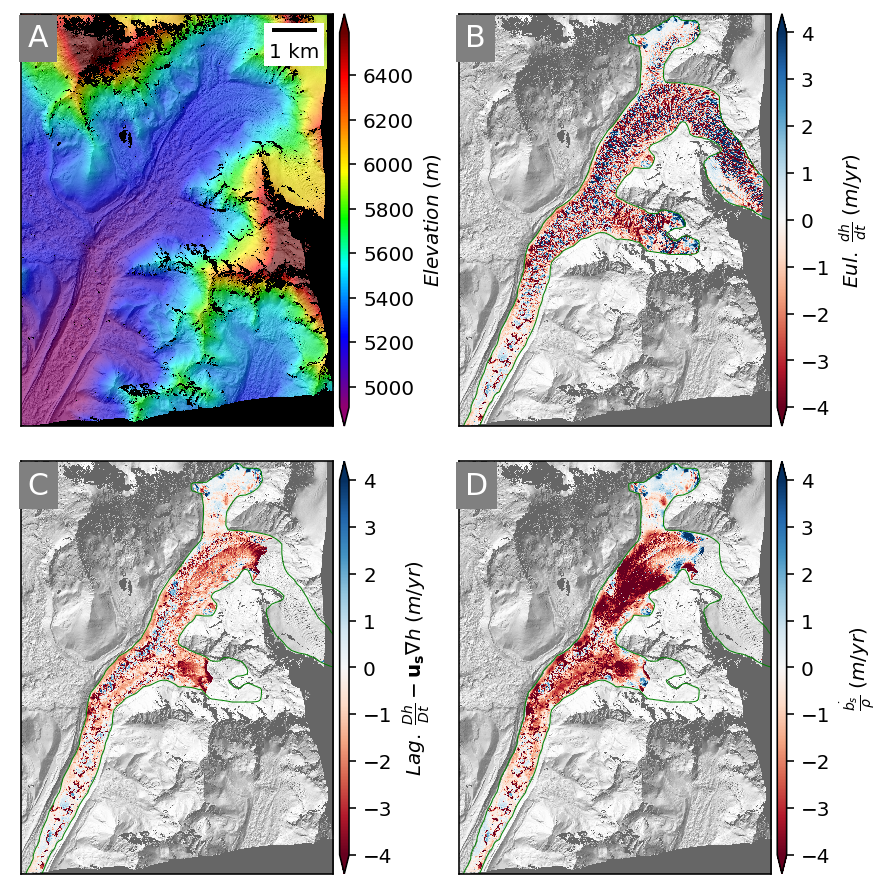

In [39]:
f,axa = plt.subplots(2,2,sharex=True,sharey=True,figsize=(6,8))
ax = axa.ravel()
pltlib.iv(dem1,ax=ax[0],hillshade=True,ds=ds_list[0],scalebar=False,extent=fig_extent,skinny=False,label='$Elevation \; (m)$',full_bg_stretch=True,overlay_alpha=0.6)
pltlib.add_scalebar(ax[0],res=1,location='upper right')
pltlib.iv(eul,ax=ax[1],cmap='RdBu',clim=(-4,4),hillshade=True,ds=ds_list[0],scalebar=False,extent=fig_extent,
          skinny=False,label=r'$Eul.\; \frac{dh}{dt} \; (m/yr)$',full_bg_stretch=False,overlay_alpha=1)
pltlib.iv(lag-slope_parallel,ax=ax[2],cmap='RdBu',clim=(-4,4),hillshade=True,ds=ds_list[0],scalebar=False,
          extent=fig_extent,skinny=False,label=r'$Lag. \; \frac{Dh}{Dt} - \mathbf{u_{s}}{\nabla h} \; (m/yr)$',full_bg_stretch=False,overlay_alpha=1)
pltlib.iv(smb,ax=ax[3],cmap='RdBu',clim=(-4,4),hillshade=True,ds=ds_list[0],scalebar=False,extent=fig_extent,
          skinny=False,label=r'$\frac{\dot{{b}_{s}}}{\rho}\;(m/yr)$ ',full_bg_stretch=False,overlay_alpha=1)
linewidth = 0.5
for idx,ax in enumerate(axa.ravel()):
    if idx == 0:
        continue
    else:
        glac_shp.plot(ax=ax,facecolor='None',edgecolor='green',linewidth=linewidth)
        ax.set_xlim(fig_extent[0],fig_extent[1])
        ax.set_ylim(fig_extent[2],fig_extent[3])
plt.tight_layout(pad=-0.1, w_pad=0.2, h_pad=0.05)
ax = axa.ravel()
t = ax[0].text(0.020,0.92,'A',
    color='white', fontsize=15,transform=ax[0].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))
t = ax[1].text(0.020,0.92,'B',
    color='white', fontsize=15,transform=ax[1].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))
t = ax[2].text(0.020,0.92,'C',
    color='white', fontsize=15,transform=ax[2].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))
t = ax[3].text(0.020,0.92,'D',
    color='white', fontsize=15,transform=ax[3].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))
f.savefig('figures/khumbu_smb.png',dpi=300,bbox_inches='tight',pad_inches=0.1)

## 5. Langtang

In [87]:
dem1_fn = 'langtang/20150222_aligned/20150222_aligned-trans_source-DEM.tif'
eul_fn = 'langtang/20230223/langtang_farinotti_2015-02-22_to_2016-01-07_lag_smb_products/langtang_farinotti_2015-02-22_to_2016-01-07_eulerian_dhdt.tif'
lag_fn = 'langtang/20230223/langtang_farinotti_2015-02-22_to_2016-01-07_lag_smb_products/langtang_farinotti_2015-02-22_to_2016-01-07_lagrangian_dhdt.tif'
slope_parallel_fn = 'langtang/20230223/langtang_farinotti_2015-02-22_to_2016-01-07_lag_smb_products/langtang_farinotti_2015-02-22_to_2016-01-07_downslope_dhdt.tif'
smb_fn = 'langtang/20230223/langtang_farinotti_2015-02-22_to_2016-01-07_lag_smb_products/langtang_farinotti_2015-02-22_to_2016-01-07_smb_dhdt.tif'
ortho_img_fn = 'langtang/20230223/orthoimage/20160107_103001004E783B00_ortho_res_2.0m.tif'
glac_shp = gpd.read_file(constants.fetch_glac_shp(constants.rgi_dicts['langtang'])).to_crs('EPSG:32645')
ds_list = warplib.memwarp_multi_fn([dem1_fn,eul_fn,lag_fn,slope_parallel_fn,smb_fn,ortho_img_fn],res='last',r='average')

dem1,eul,lag,slope_parallel,smb,ortho_img = [iolib.ds_getma(ds) for ds in ds_list]
eul = velocity_timeseries.mask_by_shp(glac_shp.geometry,eul,ds=ds_list[1])
lag = velocity_timeseries.mask_by_shp(glac_shp.geometry,lag,ds=ds_list[1])
#vx = velocity_timeseries.mask_by_shp(glac_shp.geometry,iolib.ds_getma(vx_ds),vx_ds)
#vy = velocity_timeseries.mask_by_shp(glac_shp.geometry,iolib.ds_getma(vy_ds),vy_ds)
#divq2 = velocity_timeseries.mask_by_shp(glac_shp.geometry,divq2,ds_list[2])
res = geolib.get_res(ds_list[0])[0]
ds_extent = geolib.ds_extent(ds_list[0])
fig_extent = [ds_extent[0],ds_extent[2],ds_extent[1],ds_extent[3]]
contour_extent = [fig_extent[0],fig_extent[1],fig_extent[3],fig_extent[2]] # flip y axis otherwise contours are plotted flipped


Warping all inputs to the following:
Resolution: 2.0
Extent: [368087.5, 3121737.5, 375912.5, 3139937.5]
Projection: '+proj=utm +zone=45 +datum=WGS84 +units=m +no_defs'
Resampling alg: average

1 of 6: langtang/20150222_aligned/20150222_aligned-trans_source-DEM.tif
nl: 9100 ns: 3912 res: 2.000
100 - done.
0...10...20...30...40...50...60...70...80...90...2 of 6: langtang/20230223/langtang_farinotti_2015-02-22_to_2016-01-07_lag_smb_products/langtang_farinotti_2015-02-22_to_2016-01-07_eulerian_dhdt.tif
nl: 9100 ns: 3912 res: 2.000
100 - done.
0...10...20...30...40...50...60...70...80...90...3 of 6: langtang/20230223/langtang_farinotti_2015-02-22_to_2016-01-07_lag_smb_products/langtang_farinotti_2015-02-22_to_2016-01-07_lagrangian_dhdt.tif
nl: 9100 ns: 3912 res: 2.000
100 - done.
0...10...20...30...40...50...60...70...80...90...4 of 6: langtang/20230223/langtang_farinotti_2015-02-22_to_2016-01-07_lag_smb_products/langtang_farinotti_2015-02-22_to_2016-01-07_downslope_dhdt.tif
nl: 9100 ns: 3

### Check for mass conservation in Lagrangian corrections

In [88]:
mask = malib.common_mask([eul,lag,slope_parallel,smb])

In [92]:
slope_corrected_lag_conservation = malib.get_stats_dict(np.ma.array(eul,mask=mask))['mean']-malib.get_stats_dict(np.ma.array(lag-slope_parallel,mask=mask))['mean']
print (f"Difference between Eul. dh/dt and slope-corrected Lag Dh/Dt for Langtang Glacier is {np.round(slope_corrected_lag_conservation,2)} m/yr")

Difference between Eul. dh/dt and slope-corrected Lag Dh/Dt for Langtang Glacier is 0.01 m/yr


In [89]:
malib.get_stats_dict(np.ma.array(eul,mask=mask))

{'count': 6130427,
 'min': -37.169334411621094,
 'max': 45.386966705322266,
 'ptp': 82.55630493164062,
 'mean': -1.1674033252968918,
 'std': 2.8814435072039375,
 'nmad': 1.6671586566925047,
 'med': -0.8682156801223755,
 'median': -0.8682156801223755,
 'p16': -3.0144166946411133,
 'p84': 0.6185827255249023,
 'spread': 1.8164997100830078,
 'mode': -0.4132963716983795}

In [90]:
malib.get_stats_dict(np.ma.array(lag-slope_parallel,mask=mask))

{'count': 6130427,
 'min': -42.3512906275292,
 'max': 45.407815551056046,
 'ptp': 87.75910617858526,
 'mean': -1.1795143004540187,
 'std': 2.508753209922663,
 'nmad': 1.328577710154644,
 'med': -0.8582058557757721,
 'median': -0.8582058557757721,
 'p16': -2.6931663992945034,
 'p84': 0.26062304306573203,
 'spread': 1.4768947211801178,
 'mode': -36.581455796689255}

In [91]:
malib.get_stats_dict(np.ma.array(smb,mask=mask))

{'count': 6130427,
 'min': -39.17256443465757,
 'max': 44.9050752275125,
 'ptp': 84.07763966217007,
 'mean': -1.3657876948133851,
 'std': 2.9732705717811765,
 'nmad': 1.7839537135522696,
 'med': -0.983915882489219,
 'median': -0.983915882489219,
 'p16': -3.5599649621854477,
 'p84': 0.5388634302306616,
 'spread': 2.0494141962080548,
 'mode': -39.17256443465757}

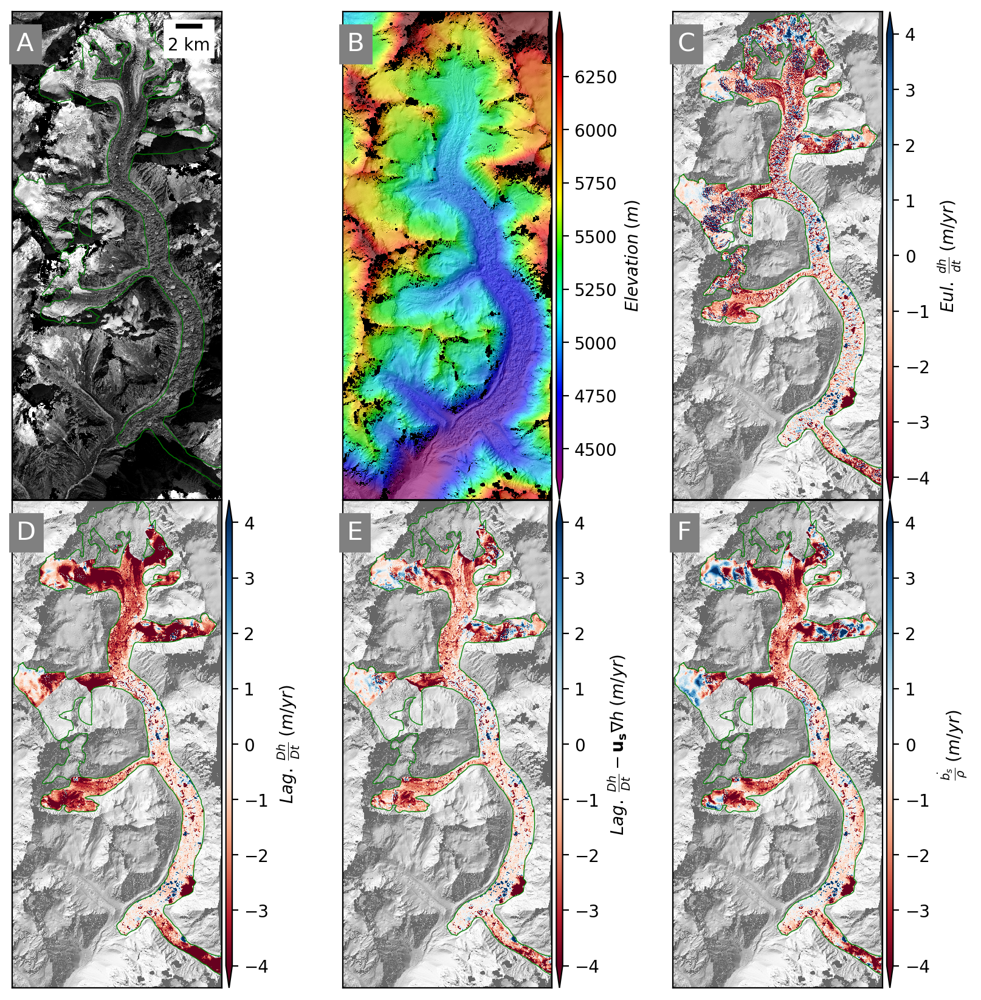

In [93]:
f,axa = plt.subplots(2,3,sharex=True,sharey=True,figsize=(8.5,8))
ax = axa.ravel()
#pltlib.iv(ortho_img,ax=ax[0],cmap='gray',extent=fig_extent,skinny=False,cbar=False,clim=malib.calcperc(ortho_img,(0,80)))
#im2 = ax[0].imshow(exposure.equalize_adapthist(norm(ortho_img, verbose=False).data), cmap='gray', extent=fig_extent)
#ax[0].set_xticks([])
#ax[0].set_yticks([])
pltlib.iv(exposure.equalize_adapthist(norm(ortho_img, verbose=False).data),ax=ax[0],cmap='gray',extent=fig_extent,skinny=False,cbar=False)
pltlib.iv(dem1,ax=ax[1],hillshade=True,ds=ds_list[0],scalebar=False,extent=fig_extent,skinny=False,label='$Elevation \; (m)$',full_bg_stretch=True,overlay_alpha=0.6)
pltlib.add_scalebar(ax[0],res=2,location='upper right')
pltlib.iv(eul,ax=ax[2],cmap='RdBu',clim=(-4,4),hillshade=True,ds=ds_list[0],scalebar=False,extent=fig_extent,
          skinny=False,label=r'$Eul.\; \frac{dh}{dt} \; (m/yr)$',full_bg_stretch=False,overlay_alpha=1)
pltlib.iv(lag,ax=ax[3],cmap='RdBu',clim=(-4,4),hillshade=True,ds=ds_list[0],scalebar=False,extent=fig_extent,
          skinny=False,label=r'$Lag.\; \frac{Dh}{Dt} \; (m/yr)$',full_bg_stretch=False,overlay_alpha=1)
pltlib.iv(lag-slope_parallel,ax=ax[4],cmap='RdBu',clim=(-4,4),hillshade=True,ds=ds_list[0],scalebar=False,
          extent=fig_extent,skinny=False,label=r'$Lag. \; \frac{Dh}{Dt} - \mathbf{u_{s}}{\nabla h} \; (m/yr)$',full_bg_stretch=False,overlay_alpha=1)
pltlib.iv(smb,ax=ax[5],cmap='RdBu',clim=(-4,4),hillshade=True,ds=ds_list[0],scalebar=False,extent=fig_extent,
          skinny=False,label=r'$\frac{\dot{{b}_{s}}}{\rho}\;(m/yr)$ ',full_bg_stretch=False,overlay_alpha=1)
linewidth = 0.5
for idx,ax in enumerate(axa.ravel()):
    ax.set_xlim(fig_extent[0],fig_extent[1])
    ax.set_ylim(fig_extent[2],fig_extent[3])
    if idx == 1:
        continue
    else:
        glac_shp.plot(ax=ax,facecolor='None',edgecolor='green',linewidth=linewidth)
    ax.set_xlim(fig_extent[0],fig_extent[1])
    ax.set_ylim(fig_extent[2],fig_extent[3])
plt.tight_layout(pad=-0.1, w_pad=0.2, h_pad=0.05)
ax = axa.ravel()
t = ax[0].text(0.020,0.92,'A',
    color='white', fontsize=15,transform=ax[0].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))
t = ax[1].text(0.020,0.92,'B',
    color='white', fontsize=15,transform=ax[1].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))
t = ax[2].text(0.020,0.92,'C',
    color='white', fontsize=15,transform=ax[2].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))
t = ax[3].text(0.020,0.92,'D',
    color='white', fontsize=15,transform=ax[3].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))
t = ax[4].text(0.020,0.92,'E',
    color='white', fontsize=15,transform=ax[4].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))
t = ax[5].text(0.020,0.92,'F',
    color='white', fontsize=15,transform=ax[5].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))

f.savefig('figures/langtang_smb_300_6panel.png',dpi=300,bbox_inches='tight',pad_inches=0.1)

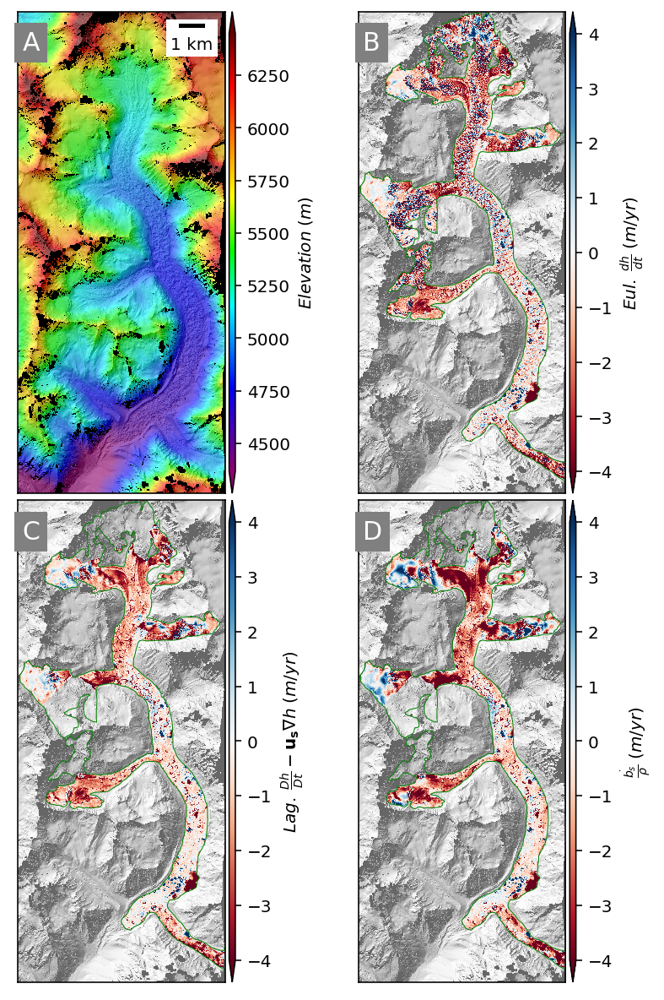

In [15]:
f,axa = plt.subplots(2,2,sharex=True,sharey=True,figsize=(6,8))
ax = axa.ravel()
pltlib.iv(dem1,ax=ax[0],hillshade=True,ds=ds_list[0],scalebar=False,extent=fig_extent,skinny=False,label='$Elevation \; (m)$',full_bg_stretch=True,overlay_alpha=0.6)
pltlib.add_scalebar(ax[0],res=1,location='upper right')
pltlib.iv(eul,ax=ax[1],cmap='RdBu',clim=(-4,4),hillshade=True,ds=ds_list[0],scalebar=False,extent=fig_extent,
          skinny=False,label=r'$Eul.\; \frac{dh}{dt} \; (m/yr)$',full_bg_stretch=False,overlay_alpha=1)
pltlib.iv(lag-slope_parallel,ax=ax[2],cmap='RdBu',clim=(-4,4),hillshade=True,ds=ds_list[0],scalebar=False,
          extent=fig_extent,skinny=False,label=r'$Lag. \; \frac{Dh}{Dt} - \mathbf{u_{s}}{\nabla h} \; (m/yr)$',full_bg_stretch=False,overlay_alpha=1)
pltlib.iv(smb,ax=ax[3],cmap='RdBu',clim=(-4,4),hillshade=True,ds=ds_list[0],scalebar=False,extent=fig_extent,
          skinny=False,label=r'$\frac{\dot{{b}_{s}}}{\rho}\;(m/yr)$ ',full_bg_stretch=False,overlay_alpha=1)
linewidth = 0.5
for idx,ax in enumerate(axa.ravel()):
    if idx == 0:
        continue
    else:
        glac_shp.plot(ax=ax,facecolor='None',edgecolor='green',linewidth=linewidth)
        ax.set_xlim(fig_extent[0],fig_extent[1])
        ax.set_ylim(fig_extent[2],fig_extent[3])
plt.tight_layout(pad=-0.1, w_pad=0.2, h_pad=0.05)
ax = axa.ravel()
t = ax[0].text(0.020,0.92,'A',
    color='white', fontsize=15,transform=ax[0].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))
t = ax[1].text(0.020,0.92,'B',
    color='white', fontsize=15,transform=ax[1].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))
t = ax[2].text(0.020,0.92,'C',
    color='white', fontsize=15,transform=ax[2].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))
t = ax[3].text(0.020,0.92,'D',
    color='white', fontsize=15,transform=ax[3].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))
f.savefig('figures/langtang_smb.png',dpi=300,bbox_inches='tight',pad_inches=0.1)

## 6. Lirung

In [94]:
dem1_fn = 'lirung/20161106_0456_103001005FAB7A00_103001005F7EBB00-DEM_2m_align.tif'
eul_fn = 'lirung/202320218/lirung_farinotti_2016-11-06_to_2017-12-22_lag_smb_products/lirung_farinotti_2016-11-06_to_2017-12-22_eulerian_dhdt.tif'
lag_fn = 'lirung/202320218/lirung_farinotti_2016-11-06_to_2017-12-22_lag_smb_products/lirung_farinotti_2016-11-06_to_2017-12-22_lagrangian_dhdt.tif'
slope_parallel_fn = 'lirung/202320218/lirung_farinotti_2016-11-06_to_2017-12-22_lag_smb_products/lirung_farinotti_2016-11-06_to_2017-12-22_downslope_dhdt.tif'
smb_fn = 'lirung/202320218/lirung_farinotti_2016-11-06_to_2017-12-22_lag_smb_products/lirung_farinotti_2016-11-06_to_2017-12-22_smb_dhdt.tif'
ortho_img_fn = 'lirung/202320218/ortho2m/20161106_103001005FAB7A00_ortho_res_2.0m.tif'
glac_shp = gpd.read_file(constants.fetch_glac_shp(constants.rgi_dicts['lirung'])).to_crs('EPSG:32645')
ds_list = warplib.memwarp_multi_fn([dem1_fn,eul_fn,lag_fn,slope_parallel_fn,smb_fn,ortho_img_fn],res='last',r='average')

dem1,eul,lag,slope_parallel,smb,ortho_img = [iolib.ds_getma(ds) for ds in ds_list]
eul = velocity_timeseries.mask_by_shp(glac_shp.geometry,eul,ds=ds_list[1])
lag = velocity_timeseries.mask_by_shp(glac_shp.geometry,lag,ds=ds_list[1])
#vx = velocity_timeseries.mask_by_shp(glac_shp.geometry,iolib.ds_getma(vx_ds),vx_ds)
#vy = velocity_timeseries.mask_by_shp(glac_shp.geometry,iolib.ds_getma(vy_ds),vy_ds)
#divq2 = velocity_timeseries.mask_by_shp(glac_shp.geometry,divq2,ds_list[2])
res = geolib.get_res(ds_list[0])[0]
ds_extent = geolib.ds_extent(ds_list[0])
fig_extent = [ds_extent[0],ds_extent[2],ds_extent[1],ds_extent[3]]
contour_extent = [fig_extent[0],fig_extent[1],fig_extent[3],fig_extent[2]] # flip y axis otherwise contours are plotted flipped


Warping all inputs to the following:
Resolution: 2.0
Extent: [357337.5, 3122712.5, 359212.5, 3126237.5]
Projection: '+proj=utm +zone=45 +datum=WGS84 +units=m +no_defs'
Resampling alg: average

1 of 6: lirung/20161106_0456_103001005FAB7A00_103001005F7EBB00-DEM_2m_align.tif
nl: 1762 ns: 938 res: 2.000
100 - done.
0...10...20...30...40...50...60...70...80...90...2 of 6: lirung/202320218/lirung_farinotti_2016-11-06_to_2017-12-22_lag_smb_products/lirung_farinotti_2016-11-06_to_2017-12-22_eulerian_dhdt.tif
nl: 1762 ns: 938 res: 2.000
100 - done.
0...10...20...30...40...50...60...70...80...90...3 of 6: lirung/202320218/lirung_farinotti_2016-11-06_to_2017-12-22_lag_smb_products/lirung_farinotti_2016-11-06_to_2017-12-22_lagrangian_dhdt.tif
nl: 1762 ns: 938 res: 2.000
100 - done.
0...10...20...30...40...50...60...70...80...90...4 of 6: lirung/202320218/lirung_farinotti_2016-11-06_to_2017-12-22_lag_smb_products/lirung_farinotti_2016-11-06_to_2017-12-22_downslope_dhdt.tif
nl: 1762 ns: 938 res: 2.

### Check for mass conservation in Lagrangian corrections

In [96]:
mask = malib.common_mask([lag,slope_parallel,smb])

In [99]:
slope_corrected_lag_conservation = malib.get_stats_dict(np.ma.array(eul,mask=mask))['mean']-malib.get_stats_dict(np.ma.array(lag-slope_parallel,mask=mask))['mean']
print (f"Difference between Eul. dh/dt and slope-corrected Lag Dh/Dt for Lirung Glacier is {np.round(slope_corrected_lag_conservation,2)} m/yr")b

Difference between Eul. dh/dt and slope-corrected Lag Dh/Dt for Lirung Glacier is 0.04 m/yr


In [101]:
slope_corrected_lag_smb_conservation = malib.get_stats_dict(np.ma.array(eul,mask=mask))['mean']-malib.get_stats_dict(np.ma.array(smb,mask=mask))['mean']
print (f"Difference between Eul. dh/dt and Lag. SMB for Lirung Glacier is {np.round(slope_corrected_lag_smb_conservation,2)} m/yr")

Difference between Eul. dh/dt and Lag. SMB for Lirung Glacier is 0.16 m/yr


In [97]:
malib.get_stats_dict(np.ma.array(eul,mask=mask))

{'count': 318981,
 'min': -26.267566680908203,
 'max': 18.867589950561523,
 'ptp': 45.135154724121094,
 'mean': -2.0068776517221334,
 'std': 2.6448879555230724,
 'nmad': 1.2622333513498305,
 'med': -0.9444395303726196,
 'median': -0.9444395303726196,
 'p16': -4.31858434677124,
 'p84': -0.14190316200256348,
 'spread': 2.088340592384338,
 'mode': -0.2651534080505371}

In [98]:
malib.get_stats_dict(np.ma.array(lag-slope_parallel,mask=mask))

{'count': 319031,
 'min': -26.399727245193297,
 'max': 16.94026386725601,
 'ptp': 43.33999111244931,
 'mean': -2.0469416607300284,
 'std': 2.6122694013842485,
 'nmad': 1.2413356418785129,
 'med': -0.9526829873708034,
 'median': -0.9526829873708034,
 'p16': -4.325913036371484,
 'p84': -0.17488648784468264,
 'spread': 2.075513274263401,
 'mode': -0.9051321406827166}

In [63]:
malib.get_stats_dict(np.ma.array(eul,mask=mask))['mean']-malib.get_stats_dict(np.ma.array(lag-slope_parallel,mask=mask))['mean']

0.040064009007894974

In [54]:
malib.get_stats_dict(np.ma.array(smb,mask=mask))

{'count': 319032,
 'min': -26.953767625250528,
 'max': 17.885191386686326,
 'ptp': 44.83895901193685,
 'mean': -2.165511383824271,
 'std': 2.806408274009608,
 'nmad': 1.1883979103665445,
 'med': -1.031821166148931,
 'median': -1.031821166148931,
 'p16': -4.685049286124854,
 'p84': -0.24634410137547477,
 'spread': 2.2193525923746895,
 'mode': -13.412197595844091}

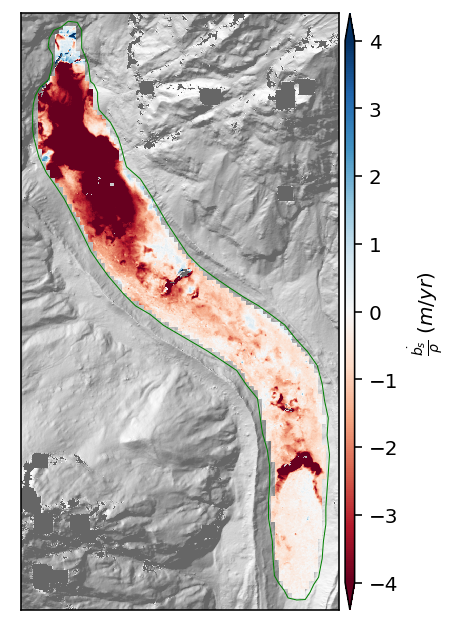

In [15]:
f,ax = plt.subplots(figsize=(3,6))
pltlib.iv(smb,ax=ax,cmap='RdBu',clim=(-4,4),hillshade=True,ds=ds_list[0],scalebar=False,extent=fig_extent,
          skinny=False,label=r'$\frac{\dot{{b}_{s}}}{\rho}\;(m/yr)$ ',full_bg_stretch=False,overlay_alpha=1)
           
linewidth = 0.5

ax.set_xlim(fig_extent[0],fig_extent[1])
ax.set_ylim(fig_extent[2],fig_extent[3])
    
glac_shp.plot(ax=ax,facecolor='None',edgecolor='green',linewidth=linewidth)
ax.set_xlim(fig_extent[0],fig_extent[1])
ax.set_ylim(fig_extent[2],fig_extent[3])
plt.tight_layout(pad=-0.1, w_pad=0.2, h_pad=0.05)
f.savefig('figures/lirung_smb_only.png',dpi=300,bbox_inches='tight',pad_inches=0.1)

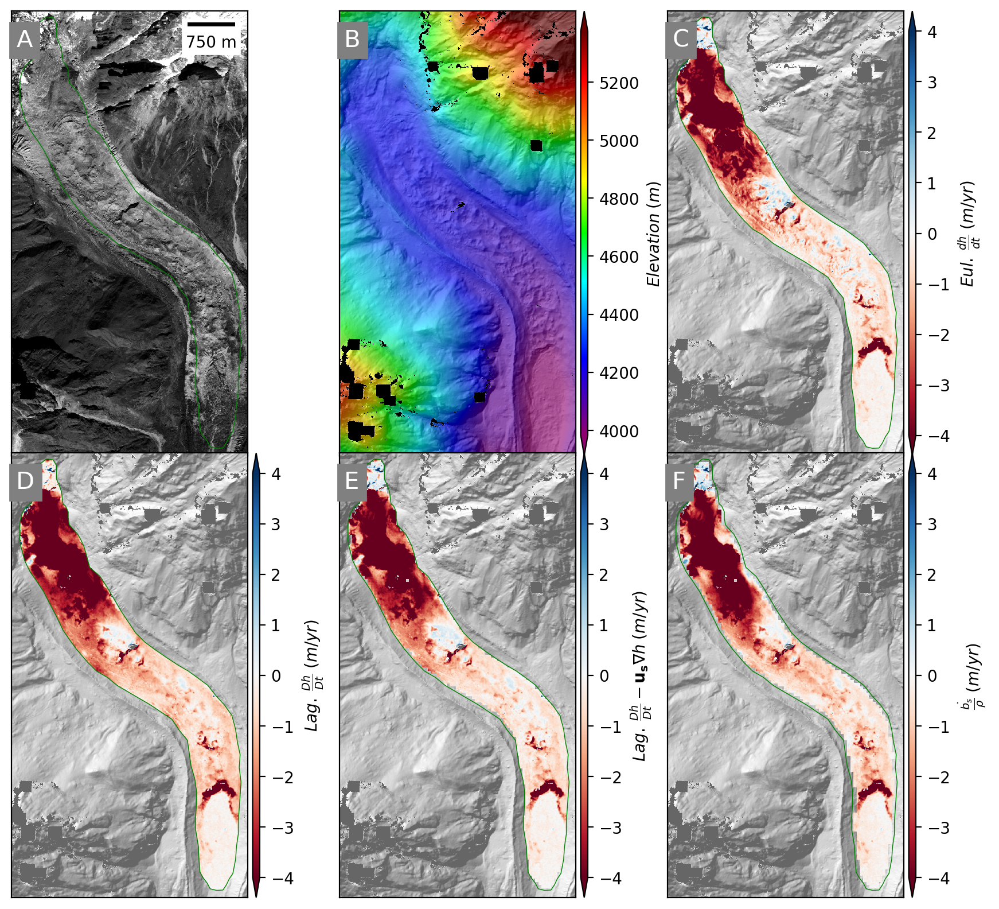

In [64]:
f,axa = plt.subplots(2,3,sharex=True,sharey=True,figsize=(8.5,8))
ax = axa.ravel()
#pltlib.iv(ortho_img,ax=ax[0],cmap='gray',extent=fig_extent,skinny=False,cbar=False,clim=malib.calcperc(ortho_img,(0,80)))
#im2 = ax[0].imshow(exposure.equalize_adapthist(norm(ortho_img, verbose=False).data), cmap='gray', extent=fig_extent)
#ax[0].set_xticks([])
#ax[0].set_yticks([])
pltlib.iv(exposure.equalize_adapthist(norm(ortho_img, verbose=False,perc_lim=(0,100)).data),ax=ax[0],cmap='gray',extent=fig_extent,skinny=False,cbar=False)
pltlib.iv(dem1,ax=ax[1],hillshade=True,ds=ds_list[0],scalebar=False,extent=fig_extent,skinny=False,label='$Elevation \; (m)$',full_bg_stretch=True,overlay_alpha=0.6)
pltlib.add_scalebar(ax[0],res=2,location='upper right')
pltlib.iv(eul,ax=ax[2],cmap='RdBu',clim=(-4,4),hillshade=True,ds=ds_list[0],scalebar=False,extent=fig_extent,
          skinny=False,label=r'$Eul.\; \frac{dh}{dt} \; (m/yr)$',full_bg_stretch=False,overlay_alpha=1)
pltlib.iv(lag,ax=ax[3],cmap='RdBu',clim=(-4,4),hillshade=True,ds=ds_list[0],scalebar=False,extent=fig_extent,
          skinny=False,label=r'$Lag.\; \frac{Dh}{Dt} \; (m/yr)$',full_bg_stretch=False,overlay_alpha=1)
pltlib.iv(lag-slope_parallel,ax=ax[4],cmap='RdBu',clim=(-4,4),hillshade=True,ds=ds_list[0],scalebar=False,
          extent=fig_extent,skinny=False,label=r'$Lag. \; \frac{Dh}{Dt} - \mathbf{u_{s}}{\nabla h} \; (m/yr)$',full_bg_stretch=False,overlay_alpha=1)
pltlib.iv(smb,ax=ax[5],cmap='RdBu',clim=(-4,4),hillshade=True,ds=ds_list[0],scalebar=False,extent=fig_extent,
          skinny=False,label=r'$\frac{\dot{{b}_{s}}}{\rho}\;(m/yr)$ ',full_bg_stretch=False,overlay_alpha=1)
linewidth = 0.5
for idx,ax in enumerate(axa.ravel()):
    ax.set_xlim(fig_extent[0],fig_extent[1])
    ax.set_ylim(fig_extent[2],fig_extent[3])
    if idx == 1:
        continue
    else:
        glac_shp.plot(ax=ax,facecolor='None',edgecolor='green',linewidth=linewidth)
    ax.set_xlim(fig_extent[0],fig_extent[1])
    ax.set_ylim(fig_extent[2],fig_extent[3])
plt.tight_layout(pad=-0.1, w_pad=0.2, h_pad=0.05)
ax = axa.ravel()
t = ax[0].text(0.020,0.92,'A',
    color='white', fontsize=15,transform=ax[0].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))
t = ax[1].text(0.020,0.92,'B',
    color='white', fontsize=15,transform=ax[1].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))
t = ax[2].text(0.020,0.92,'C',
    color='white', fontsize=15,transform=ax[2].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))
t = ax[3].text(0.020,0.92,'D',
    color='white', fontsize=15,transform=ax[3].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))
t = ax[4].text(0.020,0.92,'E',
    color='white', fontsize=15,transform=ax[4].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))
t = ax[5].text(0.020,0.92,'F',
    color='white', fontsize=15,transform=ax[5].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))

f.savefig('figures/lirung_smb_300_6panel.png',dpi=300,bbox_inches='tight',pad_inches=0.1)

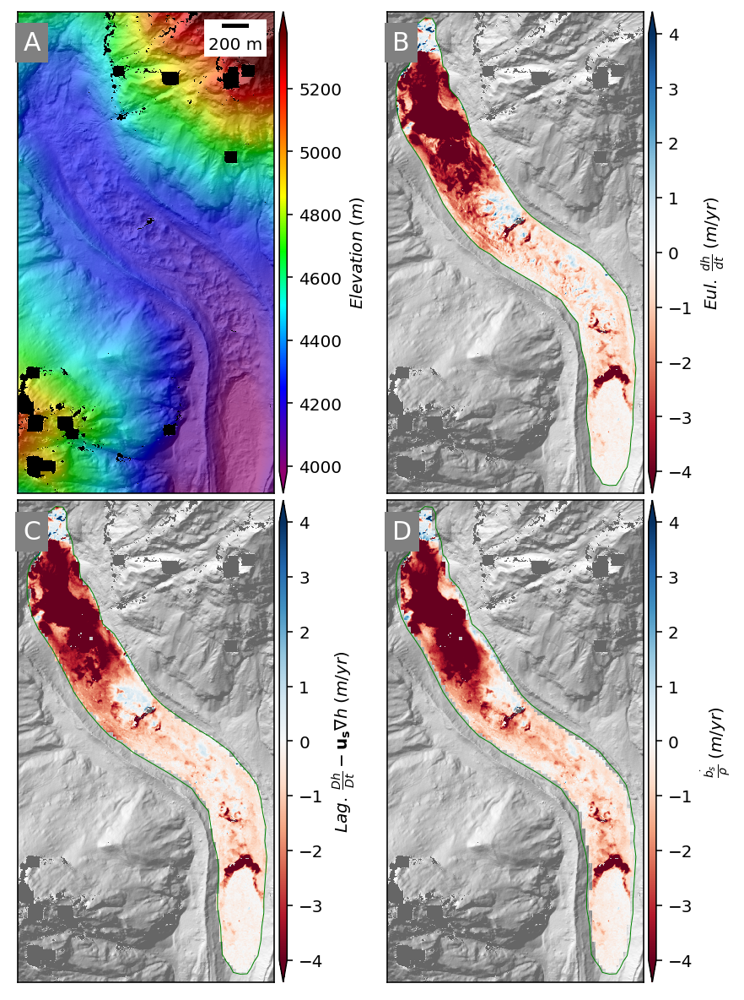

In [55]:
f,axa = plt.subplots(2,2,sharex=True,sharey=True,figsize=(6,8))
ax = axa.ravel()
pltlib.iv(dem1,ax=ax[0],hillshade=True,ds=ds_list[0],scalebar=False,extent=fig_extent,skinny=False,label='$Elevation \; (m)$',full_bg_stretch=True,overlay_alpha=0.6)
pltlib.add_scalebar(ax[0],res=1,location='upper right')
pltlib.iv(eul,ax=ax[1],cmap='RdBu',clim=(-4,4),hillshade=True,ds=ds_list[0],scalebar=False,extent=fig_extent,
          skinny=False,label=r'$Eul.\; \frac{dh}{dt} \; (m/yr)$',full_bg_stretch=False,overlay_alpha=1)
pltlib.iv(lag-slope_parallel,ax=ax[2],cmap='RdBu',clim=(-4,4),hillshade=True,ds=ds_list[0],scalebar=False,
          extent=fig_extent,skinny=False,label=r'$Lag. \; \frac{Dh}{Dt} - \mathbf{u_{s}}{\nabla h} \; (m/yr)$',full_bg_stretch=False,overlay_alpha=1)
pltlib.iv(smb,ax=ax[3],cmap='RdBu',clim=(-4,4),hillshade=True,ds=ds_list[0],scalebar=False,extent=fig_extent,
          skinny=False,label=r'$\frac{\dot{{b}_{s}}}{\rho}\;(m/yr)$ ',full_bg_stretch=False,overlay_alpha=1)
linewidth = 0.5
for idx,ax in enumerate(axa.ravel()):
    if idx == 0:
        continue
    else:
        glac_shp.plot(ax=ax,facecolor='None',edgecolor='green',linewidth=linewidth)
        ax.set_xlim(fig_extent[0],fig_extent[1])
        ax.set_ylim(fig_extent[2],fig_extent[3])
plt.tight_layout(pad=-0.1, w_pad=0.2, h_pad=0.05)
ax = axa.ravel()
t = ax[0].text(0.020,0.92,'A',
    color='white', fontsize=15,transform=ax[0].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))
t = ax[1].text(0.020,0.92,'B',
    color='white', fontsize=15,transform=ax[1].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))
t = ax[2].text(0.020,0.92,'C',
    color='white', fontsize=15,transform=ax[2].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))
t = ax[3].text(0.020,0.92,'D',
    color='white', fontsize=15,transform=ax[3].transAxes)
t.set_bbox(dict(facecolor='gray', alpha=1, edgecolor='gray'))
f.savefig('figures/lirung_smb.png',dpi=300,bbox_inches='tight',pad_inches=0.1)